**Project: Enhancing Stock Trading Strategies using Deep Reinforcement Learning**

# **Install Dependencies**

In [1]:
!pip install gym-anytrading gym
!pip install git+https://github.com/DLR-RM/stable-baselines3
# !pip install stable-baselines3[extra]
!pip install shimmy
!pip install optuna
!pip install finta

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 172.0/172.0 kB 4.1 MB/s eta 0:00:00
  Cloning https://github.com/DLR-RM/stable-baselines3 to /tmp/pip-req-build-vro1oxar
  Running command git clone --filter=blob:none --quiet https://github.com/DLR-RM/stable-baselines3 /tmp/pip-req-build-vro1oxar
  Resolved https://github.com/DLR-RM/stable-baselines3 to commit ff2115d5622f52828117c4a972cee63d0d0f1f2b
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 953.8/953.8 kB 9.1 MB/s eta 0:00:00
  Created wheel for stable-baselines3: filename=stable_baselines3-2.1.0a4-py3-none-any.whl size=178763 sha256=07db7862bc8a15cbe2ce93271468fa1f55f5a1d0dc9e4fa6fd98e6d9ac3ef4d7
  Stored in directory: /tmp/pip-ephem-wheel-cache-nojzvixr/wheels/3b/24/65/bc2794face336930a72bdbe36faf5aad6e2352b3d1dec310ca
Successfully built stable-baselines3
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40

# **Data Preprocessing**

In [2]:
import gym
import gym_anytrading
from gym import spaces

from stable_baselines3.common.vec_env import DummyVecEnv
from stable_baselines3 import HerReplayBuffer, A2C, PPO, DQN
from stable_baselines3.common.callbacks import BaseCallback, EvalCallback, StopTrainingOnNoModelImprovement
from stable_baselines3.common.buffers import ReplayBuffer
from stable_baselines3.common.evaluation import evaluate_policy

import numpy as np
import pandas as pd
from matplotlib import pyplot as plt


/usr/local/lib/python3.10/dist-packages/torch/utils/tensorboard/__init__.py:4: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if not hasattr(tensorboard, "__version__") or LooseVersion(


In [3]:
from google.colab import drive

drive.mount('/content/drive')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/pexpect/popen_spawn.py:60: DeprecationWarning: setDaemon() is deprecated, set the daemon attribute instead
  self._read_thread.setDaemon(True)


Mounted at /content/drive


In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Advanced Computing/Individual Project/data/apple.csv')
df.head()


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,Date,Open,High,Low,Close,Volume
0,05/19/2023,176.39,176.39,174.94,175.16,"55,809,480"
1,05/18/2023,173.00,175.24,172.58,175.05,"65,496,660"
2,05/17/2023,171.71,172.93,170.42,172.69,"57,951,602"
3,05/16/2023,171.99,173.14,171.80,172.07,"42,110,289"
4,05/15/2023,173.16,173.21,171.47,172.07,"37,266,660"


import numpy as np
from google.colab import autoviz

def value_plot(df, y, figscale=1):
  from matplotlib import pyplot as plt
  df[y].plot(kind='line', figsize=(8 * figscale, 4 * figscale), title=y)
  plt.gca().spines[['top', 'right']].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = value_plot(_df_20, *['Open'], **{})
chart

import numpy as np
from google.colab import autoviz

def value_plot(df, y, figscale=1):
  from matplotlib import pyplot as plt
  df[y].plot(kind='line', figsize=(8 * figscale, 4 * figscale), title=y)
  plt.gca().spines[['top', 'right']].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = value_plot(_df_21, *['High'], **{})
chart

import numpy as np
from google.colab import autoviz

def value_plot(df, y, figscale=1):
  from matplotlib import pyplot as plt
  df[y].plot(kind='line', figsize=(8 * figscale, 4 * figscale), title=y)
  plt.gca().spines[['top', 'right']].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = value_plot(_df_22, *['Low'], **{})
chart

import numpy as np
from google.colab import autoviz

def value_plot(df, y, figscale=1):
  from matplotlib import pyplot as plt
  df[y].plot(kind='line', figsize=(8 * figscale, 4 * figscale), title=y)
  plt.gca().spines[['top', 'right']].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = value_plot(_df_23, *['Close'], **{})
chart

import numpy as np
from google.colab import autoviz

def histogram(df, colname, num_bins=20, figscale=1):
  from matplotlib import pyplot as plt
  df[colname].plot(kind='hist', bins=num_bins, title=colname, figsize=(8*figscale, 4*figscale))
  plt.gca().spines[['top', 'right',]].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = histogram(_df_24, *['Open'], **{})
chart

import numpy as np
from google.colab import autoviz

def histogram(df, colname, num_bins=20, figscale=1):
  from matplotlib import pyplot as plt
  df[colname].plot(kind='hist', bins=num_bins, title=colname, figsize=(8*figscale, 4*figscale))
  plt.gca().spines[['top', 'right',]].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = histogram(_df_25, *['High'], **{})
chart

import numpy as np
from google.colab import autoviz

def histogram(df, colname, num_bins=20, figscale=1):
  from matplotlib import pyplot as plt
  df[colname].plot(kind='hist', bins=num_bins, title=colname, figsize=(8*figscale, 4*figscale))
  plt.gca().spines[['top', 'right',]].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = histogram(_df_26, *['Low'], **{})
chart

import numpy as np
from google.colab import autoviz

def histogram(df, colname, num_bins=20, figscale=1):
  from matplotlib import pyplot as plt
  df[colname].plot(kind='hist', bins=num_bins, title=colname, figsize=(8*figscale, 4*figscale))
  plt.gca().spines[['top', 'right',]].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = histogram(_df_27, *['Close'], **{})
chart

import numpy as np
from google.colab import autoviz

def categorical_histogram(df, colname, figscale=1, mpl_palette_name='Dark2'):
  from matplotlib import pyplot as plt
  import seaborn as sns
  df.groupby(colname).size().plot(kind='barh', color=sns.palettes.mpl_palette(mpl_palette_name), figsize=(8*figscale, 4.8*figscale))
  plt.gca().spines[['top', 'right',]].set_visible(False)
  return autoviz.MplChart.from_current_mpl_state()

chart = categorical_histogram(_df_28, *['Date'], **{})
chart

import numpy as np
from google.colab import autoviz

def categorical_histogram(df, colname, figscale=1, mpl_palette_name='Dark2'):
  from matplotlib import pyplot as plt
  import seaborn as sns
  df.groupby(colname).size().plot(kind='barh', color=sns.palettes.mpl_palette(mpl_palette_name), figsize=(8*figscale, 4.8*figscale))
  plt.gca().spines[['top', 'right',]].set_visible(False)
  return autoviz.MplChart.from_current_mpl_state()

chart = categorical_histogram(_df_29, *['Volume'], **{})
chart

import numpy as np
from google.colab import autoviz

def scatter_plots(df, colname_pairs, figscale=1, alpha=.8):
  from matplotlib import pyplot as plt
  plt.figure(figsize=(len(colname_pairs) * 10 * figscale, 10 * figscale))
  for plot_i, (x_colname, y_colname) in enumerate(colname_pairs, start=1):
    ax = plt.subplot(1, len(colname_pairs), plot_i)
    df.plot(kind='scatter', x=x_colname, y=y_colname, s=(32 * figscale), alpha=alpha, ax=ax)
    ax.spines[['top', 'right',]].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = scatter_plots(_df_30, *[[['Open', 'High'], ['High', 'Low'], ['Low', 'Close']]], **{})
chart

import numpy as np
from google.colab import autoviz

def heatmap(df, x_colname, y_colname, figscale=1, mpl_palette_name='viridis'):
  from matplotlib import pyplot as plt
  import seaborn as sns
  import pandas as pd
  plt.subplots(figsize=(8 * figscale, 8 * figscale))
  df_2dhist = pd.DataFrame({
      x_label: grp[y_colname].value_counts()
      for x_label, grp in df.groupby(x_colname)
  })
  sns.heatmap(df_2dhist, cmap=mpl_palette_name)
  plt.xlabel(x_colname)
  plt.ylabel(y_colname)
  return autoviz.MplChart.from_current_mpl_state()

chart = heatmap(_df_31, *['Date', 'Volume'], **{})
chart

import numpy as np
from google.colab import autoviz

def violin_plot(df, value_colname, facet_colname, figscale=1, mpl_palette_name='Dark2', **kwargs):
  from matplotlib import pyplot as plt
  import seaborn as sns
  figsize = (12 * figscale, 1.2 * figscale * len(df[facet_colname].unique()))
  plt.figure(figsize=figsize)
  sns.violinplot(df, x=value_colname, y=facet_colname, palette=mpl_palette_name, **kwargs)
  sns.despine(top=True, right=True, bottom=True, left=True)
  return autoviz.MplChart.from_current_mpl_state()

chart = violin_plot(_df_32, *['Open', 'Date'], **{'inner': 'stick'})
chart

import numpy as np
from google.colab import autoviz

def violin_plot(df, value_colname, facet_colname, figscale=1, mpl_palette_name='Dark2', **kwargs):
  from matplotlib import pyplot as plt
  import seaborn as sns
  figsize = (12 * figscale, 1.2 * figscale * len(df[facet_colname].unique()))
  plt.figure(figsize=figsize)
  sns.violinplot(df, x=value_colname, y=facet_colname, palette=mpl_palette_name, **kwargs)
  sns.despine(top=True, right=True, bottom=True, left=True)
  return autoviz.MplChart.from_current_mpl_state()

chart = violin_plot(_df_33, *['Open', 'Volume'], **{'inner': 'stick'})
chart

import numpy as np
from google.colab import autoviz

def violin_plot(df, value_colname, facet_colname, figscale=1, mpl_palette_name='Dark2', **kwargs):
  from matplotlib import pyplot as plt
  import seaborn as sns
  figsize = (12 * figscale, 1.2 * figscale * len(df[facet_colname].unique()))
  plt.figure(figsize=figsize)
  sns.violinplot(df, x=value_colname, y=facet_colname, palette=mpl_palette_name, **kwargs)
  sns.despine(top=True, right=True, bottom=True, left=True)
  return autoviz.MplChart.from_current_mpl_state()

chart = violin_plot(_df_34, *['High', 'Date'], **{'inner': 'stick'})
chart

import numpy as np
from google.colab import autoviz

def violin_plot(df, value_colname, facet_colname, figscale=1, mpl_palette_name='Dark2', **kwargs):
  from matplotlib import pyplot as plt
  import seaborn as sns
  figsize = (12 * figscale, 1.2 * figscale * len(df[facet_colname].unique()))
  plt.figure(figsize=figsize)
  sns.violinplot(df, x=value_colname, y=facet_colname, palette=mpl_palette_name, **kwargs)
  sns.despine(top=True, right=True, bottom=True, left=True)
  return autoviz.MplChart.from_current_mpl_state()

chart = violin_plot(_df_35, *['High', 'Volume'], **{'inner': 'stick'})
chart

import numpy as np
from google.colab import autoviz

def time_series_multiline(df, timelike_colname, value_colname, series_colname, figscale=1, mpl_palette_name='Dark2'):
  from matplotlib import pyplot as plt
  import seaborn as sns
  figsize = (10 * figscale, 5.2 * figscale)
  palette = list(sns.palettes.mpl_palette(mpl_palette_name))
  def _plot_series(series, series_name, series_index=0):
    if value_colname == 'count()':
      counted = (series[timelike_colname]
                 .value_counts()
                 .reset_index(name='counts')
                 .rename({'index': timelike_colname}, axis=1)
                 .sort_values(timelike_colname, ascending=True))
      xs = counted[timelike_colname]
      ys = counted['counts']
    else:
      xs = series[timelike_colname]
      ys = series[value_colname]
    plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

  fig, ax = plt.subplots(figsize=figsize, layout='constrained')
  df = df.sort_values(timelike_colname, ascending=True)
  if series_colname:
    for i, (series_name, series) in enumerate(df.groupby(series_colname)):
      _plot_series(series, series_name, i)
    fig.legend(title=series_colname, bbox_to_anchor=(1, 1), loc='upper left')
  else:
    _plot_series(df, '')
  sns.despine(fig=fig, ax=ax)
  plt.xlabel(timelike_colname)
  plt.ylabel(value_colname)
  return autoviz.MplChart.from_current_mpl_state()

chart = time_series_multiline(_df_36, *['Date', 'Open', 'Date'], **{})
chart

import numpy as np
from google.colab import autoviz

def time_series_multiline(df, timelike_colname, value_colname, series_colname, figscale=1, mpl_palette_name='Dark2'):
  from matplotlib import pyplot as plt
  import seaborn as sns
  figsize = (10 * figscale, 5.2 * figscale)
  palette = list(sns.palettes.mpl_palette(mpl_palette_name))
  def _plot_series(series, series_name, series_index=0):
    if value_colname == 'count()':
      counted = (series[timelike_colname]
                 .value_counts()
                 .reset_index(name='counts')
                 .rename({'index': timelike_colname}, axis=1)
                 .sort_values(timelike_colname, ascending=True))
      xs = counted[timelike_colname]
      ys = counted['counts']
    else:
      xs = series[timelike_colname]
      ys = series[value_colname]
    plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

  fig, ax = plt.subplots(figsize=figsize, layout='constrained')
  df = df.sort_values(timelike_colname, ascending=True)
  if series_colname:
    for i, (series_name, series) in enumerate(df.groupby(series_colname)):
      _plot_series(series, series_name, i)
    fig.legend(title=series_colname, bbox_to_anchor=(1, 1), loc='upper left')
  else:
    _plot_series(df, '')
  sns.despine(fig=fig, ax=ax)
  plt.xlabel(timelike_colname)
  plt.ylabel(value_colname)
  return autoviz.MplChart.from_current_mpl_state()

chart = time_series_multiline(_df_37, *['Date', 'Open', 'Volume'], **{})
chart

import numpy as np
from google.colab import autoviz

def time_series_multiline(df, timelike_colname, value_colname, series_colname, figscale=1, mpl_palette_name='Dark2'):
  from matplotlib import pyplot as plt
  import seaborn as sns
  figsize = (10 * figscale, 5.2 * figscale)
  palette = list(sns.palettes.mpl_palette(mpl_palette_name))
  def _plot_series(series, series_name, series_index=0):
    if value_colname == 'count()':
      counted = (series[timelike_colname]
                 .value_counts()
                 .reset_index(name='counts')
                 .rename({'index': timelike_colname}, axis=1)
                 .sort_values(timelike_colname, ascending=True))
      xs = counted[timelike_colname]
      ys = counted['counts']
    else:
      xs = series[timelike_colname]
      ys = series[value_colname]
    plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

  fig, ax = plt.subplots(figsize=figsize, layout='constrained')
  df = df.sort_values(timelike_colname, ascending=True)
  if series_colname:
    for i, (series_name, series) in enumerate(df.groupby(series_colname)):
      _plot_series(series, series_name, i)
    fig.legend(title=series_colname, bbox_to_anchor=(1, 1), loc='upper left')
  else:
    _plot_series(df, '')
  sns.despine(fig=fig, ax=ax)
  plt.xlabel(timelike_colname)
  plt.ylabel(value_colname)
  return autoviz.MplChart.from_current_mpl_state()

chart = time_series_multiline(_df_38, *['Date', 'High', 'Date'], **{})
chart

import numpy as np
from google.colab import autoviz

def time_series_multiline(df, timelike_colname, value_colname, series_colname, figscale=1, mpl_palette_name='Dark2'):
  from matplotlib import pyplot as plt
  import seaborn as sns
  figsize = (10 * figscale, 5.2 * figscale)
  palette = list(sns.palettes.mpl_palette(mpl_palette_name))
  def _plot_series(series, series_name, series_index=0):
    if value_colname == 'count()':
      counted = (series[timelike_colname]
                 .value_counts()
                 .reset_index(name='counts')
                 .rename({'index': timelike_colname}, axis=1)
                 .sort_values(timelike_colname, ascending=True))
      xs = counted[timelike_colname]
      ys = counted['counts']
    else:
      xs = series[timelike_colname]
      ys = series[value_colname]
    plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

  fig, ax = plt.subplots(figsize=figsize, layout='constrained')
  df = df.sort_values(timelike_colname, ascending=True)
  if series_colname:
    for i, (series_name, series) in enumerate(df.groupby(series_colname)):
      _plot_series(series, series_name, i)
    fig.legend(title=series_colname, bbox_to_anchor=(1, 1), loc='upper left')
  else:
    _plot_series(df, '')
  sns.despine(fig=fig, ax=ax)
  plt.xlabel(timelike_colname)
  plt.ylabel(value_colname)
  return autoviz.MplChart.from_current_mpl_state()

chart = time_series_multiline(_df_39, *['Date', 'High', 'Volume'], **{})
chart

In [ ]:
# Convert Date column to datetime type
df['Date'] = pd.to_datetime(df['Date'])
df = df.sort_values('Date')
df.dtypes

# Run if commas in prices for each column
# df['Open'] = df['Open'].str.replace(',', '').astype(float)
# df['High'] = df['High'].str.replace(',', '').astype(float)
# df['Low'] = df['Low'].str.replace(',', '').astype(float)
# df['Close'] = df['Close'].str.replace(',', '').astype(float)
df['Volume'] = df['Volume'].str.replace(',', '').astype(float)
df.dtypes

Date      datetime64[ns]
Open             float64
High             float64
Low              float64
Close            float64
Volume           float64
dtype: object

# **Ensemble Reinforcement Learning**

## **Build Environment**

In [ ]:
env = gym.make('stocks-v0', df=df, frame_bound=(5,100), window_size=5)
env = DummyVecEnv([lambda: env])

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:31: UserWarning: WARN: A Box observation space has an unconventional shape (neither an image, nor a 1D vector). We recommend flattening the observation to have only a 1D vector or use a custom policy to properly process the data. Actual observation shape: (5, 2)
  logger.warn(
/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/loc

In [ ]:
# Access the underlying environment by getting first element from the env.envs list, since DummyVecEnv wrap multiple environments, select index 0 to access its attributes.
wrapped_env = env.envs[0]
print("Environment: ", wrapped_env.spec.id)
print("Observation Space: ", wrapped_env.observation_space)
print("Action Space: ", wrapped_env.action_space) # Dirscrete(2) - Buy/Sell
print("Data Shape: ", wrapped_env.shape) # 5 rows, 2 cols
print('\n')
print("Signal Features: \n", wrapped_env.signal_features)
print("Prices: \n", wrapped_env.prices) # array of closing prices
print("Max Possible Profit: \n", wrapped_env.max_possible_profit()) # 2.16

Environment:  stocks-v0
Observation Space:  Box(-inf, inf, (5, 2), float64)
Action Space:  Discrete(2)
Data Shape:  (5, 2)


Signal Features: 
 [[ 1.3735e+02  0.0000e+00]
 [ 1.3759e+02  2.4000e-01]
 [ 1.4311e+02  5.5200e+00]
 [ 1.4036e+02 -2.7500e+00]
 [ 1.4052e+02  1.6000e-01]
 [ 1.4378e+02  3.2600e+00]
 [ 1.4964e+02  5.8600e+00]
 [ 1.4884e+02 -8.0000e-01]
 [ 1.4871e+02 -1.3000e-01]
 [ 1.5121e+02  2.5000e+00]
 [ 1.4538e+02 -5.8300e+00]
 [ 1.4614e+02  7.6000e-01]
 [ 1.4871e+02  2.5700e+00]
 [ 1.4796e+02 -7.5000e-01]
 [ 1.4264e+02 -5.3200e+00]
 [ 1.3713e+02 -5.5100e+00]
 [ 1.3188e+02 -5.2500e+00]
 [ 1.3276e+02  8.8000e-01]
 [ 1.3543e+02  2.6700e+00]
 [ 1.3006e+02 -5.3700e+00]
 [ 1.3156e+02  1.5000e+00]
 [ 1.3587e+02  4.3100e+00]
 [ 1.3535e+02 -5.2000e-01]
 [ 1.3827e+02  2.9200e+00]
 [ 1.4166e+02  3.3900e+00]
 [ 1.4166e+02  0.0000e+00]
 [ 1.3744e+02 -4.2200e+00]
 [ 1.3923e+02  1.7900e+00]
 [ 1.3672e+02 -2.5100e+00]
 [ 1.3893e+02  2.2100e+00]
 [ 1.4156e+02  2.6300e+00]
 [ 1.4292e+02  1.36

## **Training**

* **Deep Q-Networks (DQN):** extension of Q-Learning that leverages deep neural networks to approximate the Q-value function. It can handle high-dimensional state representations. DQN has been successfully applied to various trading tasks, including stock trading and algorithmic trading.

* **Proximal Policy Optimization (PPO):** policy optimization algorithm that aims to find the optimal policy directly, without explicitly estimating the value function. PPO is known for its sample efficiency and stable learning. It has been applied to trading problems with continuous action spaces, such as portfolio management and market-making.

* **Actor-Critic Methods:** combine elements of both value-based and policy-based RL. The actor represents the policy, while the critic estimates the value function. This class of algorithms, including Advantage Actor-Critic (A2C), Asynchronous Actor-Critic (A3C) and Trust Region Policy Optimization (TRPO), can handle both discrete and continuous action spaces and is widely used in trading applications.

### **Hyperparameter Tuning**

In [ ]:
import optuna

def optimize_hyperparameters(trial: optuna.Trial, env, model_cls) -> float:

    if model_cls is DQN:
      learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-1)
      buffer_size = trial.suggest_categorical('buffer_size', [int(1e3), int(1e4), int(1e5)])
      batch_size = trial.suggest_categorical('batch_size', [16, 32, 64])
      gamma = trial.suggest_float('gamma', 0.9, 0.999)
      train_freq = trial.suggest_categorical('train_freq', [1, 4, 8])

      model = model_cls("MlpPolicy", env, learning_rate=learning_rate, buffer_size=buffer_size,
                  batch_size=batch_size, gamma=gamma, train_freq=train_freq)

    elif model_cls is PPO:
        learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-1)
        n_steps = trial.suggest_categorical('n_steps', [64, 128, 256])
        batch_size = trial.suggest_categorical('batch_size', [16, 32, 64])
        gamma = trial.suggest_float('gamma', 0.9, 0.999)
        gae_lambda = trial.suggest_float('gae_lambda', 0.8, 0.99)

        model = model_cls("MlpPolicy", env, learning_rate=learning_rate, n_steps=n_steps,
                          batch_size=batch_size, gamma=gamma, gae_lambda=gae_lambda)

    elif model_cls is A2C:
        learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-1)
        n_steps = trial.suggest_categorical('n_steps', [64, 128, 256])
        gamma = trial.suggest_float('gamma', 0.9, 0.999)

        model = model_cls("MlpPolicy", env, learning_rate=learning_rate, n_steps=n_steps,
                          gamma=gamma)

    model.learn(total_timesteps=int(1e5), log_interval=1000)

    mean_reward, _ = evaluate_policy(model, env, n_eval_episodes=5)

    env.close()

    return mean_reward

# Perform hyperparameter optimization for DQN
study_dqn = optuna.create_study(direction='maximize')
study_dqn.optimize(lambda trial: optimize_hyperparameters(trial, env, DQN), n_trials=100)

# Perform hyperparameter optimization for PPO
study_ppo = optuna.create_study(direction='maximize')
study_ppo.optimize(lambda trial: optimize_hyperparameters(trial, env, PPO), n_trials=100)

# Perform hyperparameter optimization for A2C
study_a2c = optuna.create_study(direction='maximize')
study_a2c.optimize(lambda trial: optimize_hyperparameters(trial, env, A2C), n_trials=100)

# Get the best hyperparameters for each model
best_params_dqn = study_dqn.best_params
best_params_ppo = study_ppo.best_params
best_params_a2c = study_a2c.best_params

print("Best Hyperparameters for DQN:", best_params_dqn)
print("Best Hyperparameters for PPO:", best_params_ppo)
print("Best Hyperparameters for A2C:", best_params_a2c)


[I 2023-07-15 20:00:09,629] A new study created in memory with name: no-name-1588058e-f4d7-4a6c-92da-bff36bd9f16f
<ipython-input-9-7e005ac88227>:6: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-1)
/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:174: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator.
  logger.warn(
/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:190: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed `return_info` to return information from the environment resetting.
  logger.warn(
/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_c

Best Hyperparameters for DQN: {'learning_rate': 6.735537338583968e-05, 'buffer_size': 100000, 'batch_size': 16, 'gamma': 0.9578535074143376, 'train_freq': 4}
Best Hyperparameters for PPO: {'learning_rate': 0.0010276498534028198, 'n_steps': 256, 'batch_size': 64, 'gamma': 0.9702973564540409, 'gae_lambda': 0.9508214138038605}
Best Hyperparameters for A2C: {'learning_rate': 0.0002610073739027963, 'n_steps': 128, 'gamma': 0.9331923494112836}


In [ ]:
# best_params_dqn = {'learning_rate': 6.735537338583968e-05, 'buffer_size': 100000, 'batch_size': 16, 'gamma': 0.9578535074143376, 'train_freq': 4}
# best_params_ppo = {'learning_rate': 0.0010276498534028198, 'n_steps': 256, 'batch_size': 64, 'gamma': 0.9702973564540409, 'gae_lambda': 0.9508214138038605}
# best_params_a2c = {'learning_rate': 0.0002610073739027963, 'n_steps': 128, 'gamma': 0.9331923494112836}


tb_log = "./rlmodel_optimised/"

env = gym.make('stocks-v0', df=df, frame_bound=(5,100), window_size=5)
env = DummyVecEnv([lambda: env])

# Train the models with the best hyperparameters
print("Training optimised DQN...")
best_model_dqn = DQN("MlpPolicy", env, learning_rate=best_params_dqn['learning_rate'],
                    buffer_size=best_params_dqn['buffer_size'], batch_size=best_params_dqn['batch_size'],
                    gamma=best_params_dqn['gamma'], train_freq=best_params_dqn['train_freq'], verbose=1, tensorboard_log=tb_log)
best_model_dqn.learn(total_timesteps=int(1e5))

print("Training optimised PPO...")
best_model_ppo = PPO("MlpPolicy", env, learning_rate=best_params_ppo['learning_rate'],
                    n_steps=best_params_ppo['n_steps'], batch_size=best_params_ppo['batch_size'],
                    gamma=best_params_ppo['gamma'], gae_lambda=best_params_ppo['gae_lambda'], verbose=1, tensorboard_log=tb_log)
best_model_ppo.learn(total_timesteps=int(1e5))

print("Training optimised A2C...")
best_model_a2c = A2C("MlpPolicy", env, learning_rate=best_params_a2c['learning_rate'],
                    n_steps=best_params_a2c['n_steps'], gamma=best_params_a2c['gamma'], verbose=1, tensorboard_log=tb_log)
best_model_a2c.learn(total_timesteps=int(1e5))


Training optimised DQN...
Using cuda device
Logging to ./rlmodel_optimised/DQN_1
----------------------------------
| rollout/            |          |
|    exploration_rate | 0.996    |
| time/               |          |
|    episodes         | 4        |
|    fps              | 10322    |
|    time_elapsed     | 0        |
|    total_timesteps  | 376      |
----------------------------------
----------------------------------
| rollout/            |          |
|    exploration_rate | 0.993    |
| time/               |          |
|    episodes         | 8        |
|    fps              | 11030    |
|    time_elapsed     | 0        |
|    total_timesteps  | 752      |
----------------------------------
----------------------------------
| rollout/            |          |
|    exploration_rate | 0.989    |
| time/               |          |
|    episodes         | 12       |
|    fps              | 10646    |
|    time_elapsed     | 0        |
|    total_timesteps  | 1128     |
---------

/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:174: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator.
  logger.warn(
/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:190: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed `return_info` to return information from the environment resetting.
  logger.warn(
/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:195: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed `options` to allow the environment initialisation to be passed additional information.
  logger.warn(
/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:227: DeprecationWarning: WARN: Core environment is written in old step API which returns one bool instead of two. It is recommended to rewrite the envir

Streaming output truncated to the last 5000 lines.
| time/                   |               |
|    fps                  | 503           |
|    iterations           | 3691          |
|    time_elapsed         | 1878          |
|    total_timesteps      | 944896        |
| train/                  |               |
|    approx_kl            | 0.00094121625 |
|    clip_fraction        | 0.016         |
|    clip_range           | 0.2           |
|    entropy_loss         | -0.12         |
|    explained_variance   | 0             |
|    learning_rate        | 0.00103       |
|    loss                 | 28.5          |
|    n_updates            | 36900         |
|    policy_gradient_loss | -0.00338      |
|    value_loss           | 42            |
-------------------------------------------
-----------------------------------------
| time/                   |             |
|    fps                  | 503         |
|    iterations           | 3692        |
|    time_elapsed         | 1878 

In [ ]:
from tensorboard import notebook

notebook.start("--logdir " + tb_log)


<IPython.core.display.Javascript object>

In [ ]:
# import shutil

# # List of TensorBoard log directories
# log_directories = ["./rlcustom_ac/"]

# # Remove the log directories
# for log_dir in log_directories:
#     shutil.rmtree(log_dir, ignore_errors=True)


In [ ]:
# Save models
# best_model_dqn.save("best_model_dqn")
# best_model_ppo.save("best_model_ppo")
# best_model_a2c.save("best_model_a2c")

# Load models
best_model_dqn = DQN.load("/content/drive/MyDrive/Advanced Computing/Individual Project/models/best_model_dqn")
best_model_ppo = PPO.load("/content/drive/MyDrive/Advanced Computing/Individual Project/models/best_model_ppo")
best_model_a2c = A2C.load("/content/drive/MyDrive/Advanced Computing/Individual Project/models/best_model_a2c")

## **Ensemble Model**

PPO
info {'total_reward': -2.0600000000000023, 'total_profit': 1.0482219672801594, 'position': 1}


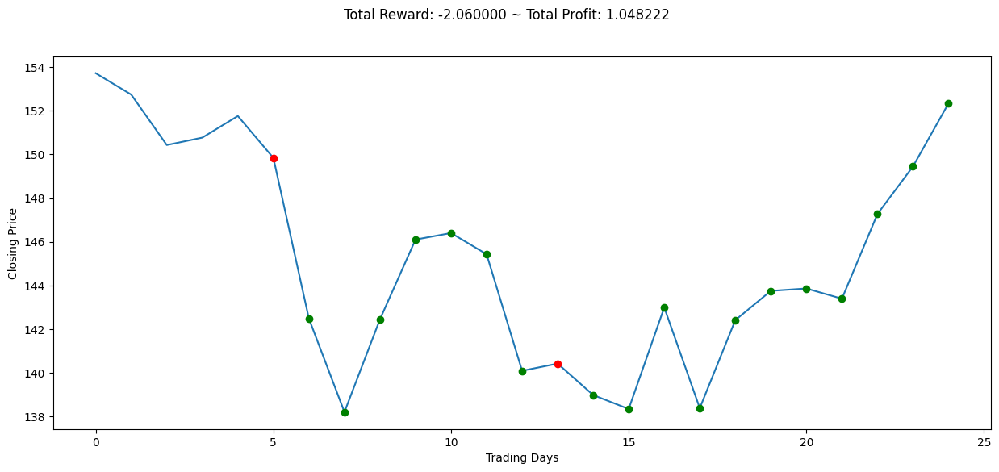

A2C
info {'total_reward': 1.2700000000000102, 'total_profit': 1.0400772191292165, 'position': 1}


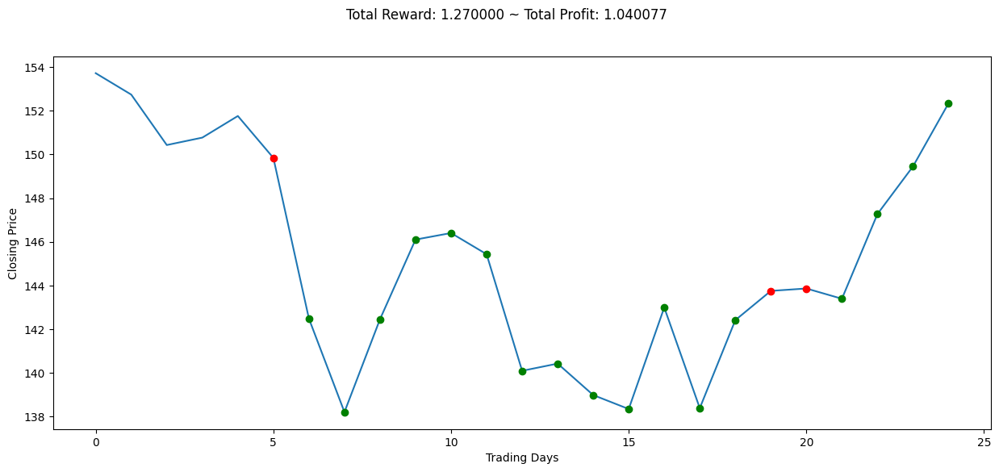

DQN
info {'total_reward': 2.9799999999999613, 'total_profit': 0.9754145156701154, 'position': 1}


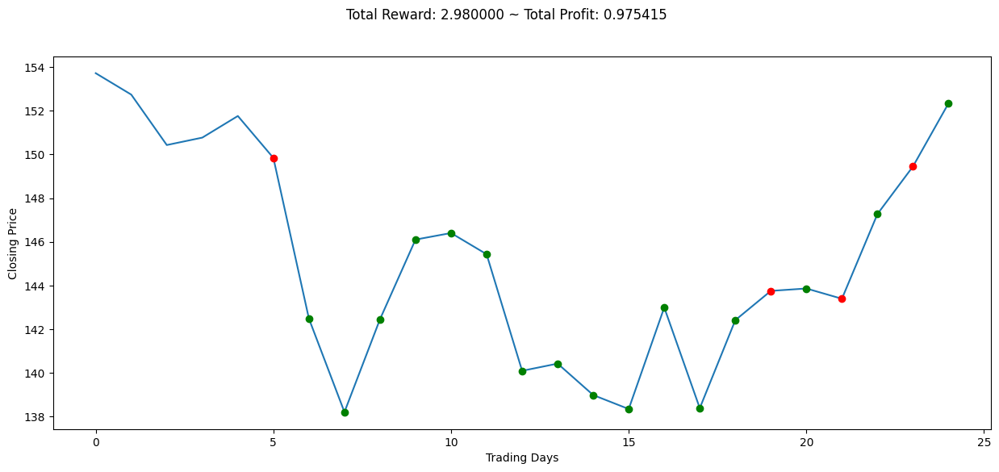

In [ ]:
model_name = ['PPO', 'A2C', 'DQN']
model_index = 0

actions_dict = {}
actions = []

prices_dict = {}
prices = []

history = []

for model in [best_model_ppo, best_model_a2c, best_model_dqn]:
  env = gym.make('stocks-v0', df=df, frame_bound=(90,110), window_size=5)
  obs = env.reset()

  while True:
      obs = obs[np.newaxis, ...] # Reshape for non-vectorized environment
      action, _states = model.predict(obs)
      obs, rewards, done, info = env.step(action)
      actions.append(action)
      prices.append(obs[4][0])
      # print(obs)

      if done:
        print(model_name[model_index])
        actions_dict[model_name[model_index]] = actions
        prices_dict[model_name[model_index]] = prices
        actions = []
        prices = []
        model_index += 1

        history.append(env.history)
        print("info", info)
        plt.figure(figsize=(15,6))
        plt.cla()
        env.render_all()

        plt.xlabel('Trading Days')
        plt.ylabel('Closing Price')

        plt.show()
        break

In [ ]:
eval_env = gym.make('stocks-v0', df=df, frame_bound=(90, 110), window_size=5)

for model in [best_model_ppo, best_model_a2c, best_model_dqn]:
  # Evaluate the policy of the trained models
  print(model)
  mean_reward, std_reward = evaluate_policy(model, eval_env, n_eval_episodes=10)

  print("Mean Reward:", mean_reward)
  print("Std Reward:", std_reward)
  print()

/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:31: UserWarning: WARN: A Box observation space has an unconventional shape (neither an image, nor a 1D vector). We recommend flattening the observation to have only a 1D vector or use a custom policy to properly process the data. Actual observation shape: (5, 2)
  logger.warn(
/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/stable_

Mean Reward: 0.0
Std Reward: 0.0

Mean Reward: 11.340000063180923
Std Reward: 0.0

Mean Reward: 3.090000092983246
Std Reward: 0.0



In [ ]:
print("Actions")
print('PPO: ', actions_dict['PPO'])
print('A2C: ', actions_dict['A2C'])
print('DQN: ', actions_dict['DQN'])

print("\nPrices")
print('PPO: ', prices_dict['PPO'])
print('A2C: ', prices_dict['A2C'])
print('DQN: ', prices_dict['DQN'])

Actions
PPO:  [array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([0]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1])]
A2C:  [array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([0]), array([0]), array([1]), array([1]), array([1]), array([1])]
DQN:  [array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([1]), array([0]), array([1]), array([0]), array([1]), array([0]), array([1])]

Prices
PPO:  [142.48, 138.2, 142.45, 146.1, 146.4, 145.43, 140.09, 140.42, 138.98, 138.34, 142.99, 138.38, 142.41, 143.75, 143.86, 143.39, 147.27, 149.45, 152.34]
A2C:  [142.48, 138.2, 142.45, 146.1, 146.4, 145.43, 140.09, 140.42, 138.98, 138.34, 142.99, 138.38, 142.41, 143.75, 143.86,

In [ ]:
# Combine actions using majority voting
voting_actions = np.array([actions_dict['PPO'], actions_dict['A2C'], actions_dict['DQN']])

# Take the majority vote for each timestep
ensemble_actions = np.apply_along_axis(lambda x: np.argmax(np.bincount(x)), axis=0, arr=voting_actions)

print("Ensemble Actions: ", ensemble_actions)


Ensemble Actions:  [[1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [0]
 [1]
 [1]
 [1]
 [1]
 [1]]


info {'total_reward': 1.2700000000000102, 'total_profit': 1.036679219038915, 'position': 1}


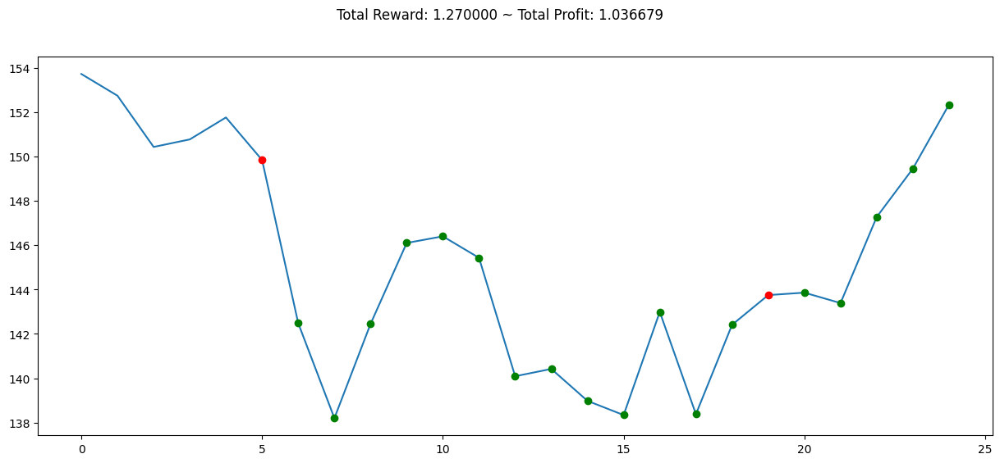

In [ ]:
# Build environment applying the voted actions
env = gym.make('stocks-v0', df=df, frame_bound=(90,110), window_size=5)
obs = env.reset()

for action in ensemble_actions:
      obs = obs[np.newaxis, ...]
      obs, rewards, done, info = env.step(action)

      if done:
        print("info", info)
        break

plt.figure(figsize=(15,6))
plt.cla()
env.render_all()
plt.show()

# **Custom Policy**

In [ ]:
best_params_dqn = {'learning_rate': 6.735537338583968e-05, 'buffer_size': 100000, 'batch_size': 16, 'gamma': 0.9578535074143376, 'train_freq': 4}
best_params_ppo = {'learning_rate': 0.0010276498534028198, 'n_steps': 256, 'batch_size': 64, 'gamma': 0.9702973564540409, 'gae_lambda': 0.9508214138038605}
best_params_a2c = {'learning_rate': 0.0002610073739027963, 'n_steps': 128, 'gamma': 0.9331923494112836}


## Recurrent Neural Network (RNN) architecture for DQN

In [ ]:
import torch as th
import torch.nn as nn
import torch.nn.functional as F
from typing import Dict
from stable_baselines3.dqn.policies import MlpPolicy
from stable_baselines3.common.torch_layers import BaseFeaturesExtractor
from stable_baselines3.common.callbacks import EvalCallback, StopTrainingOnNoModelImprovement

class RecurrentNet(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super().__init__()
        self.conv1 = nn.Conv1d(input_size, 14, kernel_size=3, stride=8)
        self.conv2 = nn.Conv1d(14, 32, kernel_size=3, stride=4)
        self.linear = nn.Linear(32, hidden_size)
        self.lstm = nn.LSTM(hidden_size, hidden_size, batch_first=True)

    def forward(self, x):
        """
        Forward pass returning encoded representation of input sequence.
        """

        batch_size = x.size(0)
        seq_len = x.size(1)

        x = x.transpose(1, 2)
        out = self.conv1(x)
        out = F.relu(out)
        out = self.conv2(out)
        out = F.relu(out)

        out = out.transpose(1, 2)
        out = self.linear(out)
        out = F.relu(out)

        hidden = self.init_hidden(batch_size)
        out, _ = self.lstm(out, hidden)
        out = out[:, -1, :]

        return out

    def init_hidden(self, batch_size):
        """
        Initialize the hidden state and cell state of the LSTM layer.
        """

        return (
            th.zeros(1, batch_size, self.hidden_size).to(self.device),
            th.zeros(1, batch_size, self.hidden_size).to(self.device)
        )


class CustomDQNNetwork(MlpPolicy):
    def __init__(self, *args, **kwargs):
        super().__init__(*args, **kwargs)

    def _build_q_net(self) -> nn.Module:
        """
        Build Q-network utilising the custom recurrent neural network architecture.
        """

        features_extractor = self.features_extractor
        self.features_extractor = None  # Remove the features extractor

        input_size = self.observation_space.shape[0]
        hidden_size = 64

        q_net = RecurrentNet(input_size, hidden_size)

        self.features_extractor = features_extractor  # Restore the features extractor

        return q_net

    def forward(self, obs: th.Tensor, deterministic: bool = True) -> th.Tensor:
        """
        Forward pass extracting features and passing through q-network and returning q values.
        """

        features = self.extract_features(obs)
        q_values = self.q_net(features)
        q_values = F.softmax(q_values, dim=-1)

        return q_values

    def extract_features(self, obs: th.Tensor) -> Dict[str, th.Tensor]:

        return self.features_extractor(obs)


env = gym.make('stocks-v0', df=df, frame_bound=(5, 100), window_size=5)
env = DummyVecEnv([lambda: env])

# Stop training if there is no improvement after more than 10 evaluations
stop_train_callback = StopTrainingOnNoModelImprovement(max_no_improvement_evals=10, min_evals=100, verbose=1)
eval_callback = EvalCallback(env, eval_freq=1000, callback_after_eval=stop_train_callback, verbose=1)

tb_log = "./rlcustom_dqn/"
best_model_dqn = DQN(policy=CustomDQNNetwork, env=env, learning_rate=best_params_dqn['learning_rate'],
                    buffer_size=best_params_dqn['buffer_size'], batch_size=best_params_dqn['batch_size'],
                    gamma=best_params_dqn['gamma'], train_freq=best_params_dqn['train_freq'], verbose=1, tensorboard_log=tb_log)

best_model_dqn.learn(total_timesteps=int(1e6), callback=eval_callback)


/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:31: UserWarning: WARN: A Box observation space has an unconventional shape (neither an image, nor a 1D vector). We recommend flattening the observation to have only a 1D vector or use a custom policy to properly process the data. Actual observation shape: (5, 2)
  logger.warn(
/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/stable_

Using cuda device
Logging to ./rlcustom_dqn/DQN_1
----------------------------------
| rollout/            |          |
|    exploration_rate | 0.996    |
| time/               |          |
|    episodes         | 4        |
|    fps              | 10571    |
|    time_elapsed     | 0        |
|    total_timesteps  | 376      |
----------------------------------
----------------------------------
| rollout/            |          |
|    exploration_rate | 0.993    |
| time/               |          |
|    episodes         | 8        |
|    fps              | 11094    |
|    time_elapsed     | 0        |
|    total_timesteps  | 752      |
----------------------------------


/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:174: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator.
  logger.warn(
/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:190: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed `return_info` to return information from the environment resetting.
  logger.warn(
/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:195: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed `options` to allow the environment initialisation to be passed additional information.
  logger.warn(
/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:227: DeprecationWarning: WARN: Core environment is written in old step API which returns one bool instead of two. It is recommended to rewrite the envir

Eval num_timesteps=1000, episode_reward=0.00 +/- 0.00
Episode length: 94.00 +/- 0.00
----------------------------------
| eval/               |          |
|    mean_ep_length   | 94       |
|    mean_reward      | 0        |
| rollout/            |          |
|    exploration_rate | 0.991    |
| time/               |          |
|    total_timesteps  | 1000     |
----------------------------------
New best mean reward!
----------------------------------
| rollout/            |          |
|    exploration_rate | 0.989    |
| time/               |          |
|    episodes         | 12       |
|    fps              | 321      |
|    time_elapsed     | 3        |
|    total_timesteps  | 1188     |
----------------------------------
----------------------------------
| rollout/            |          |
|    exploration_rate | 0.985    |
| time/               |          |
|    episodes         | 16       |
|    fps              | 420      |
|    time_elapsed     | 3        |
|    total_timeste

In [ ]:
from tensorboard import notebook

notebook.start("--logdir " + tb_log)


<IPython.core.display.Javascript object>

info {'total_reward': 14.629999999999995, 'total_profit': 1.0274573010255437, 'position': 0}


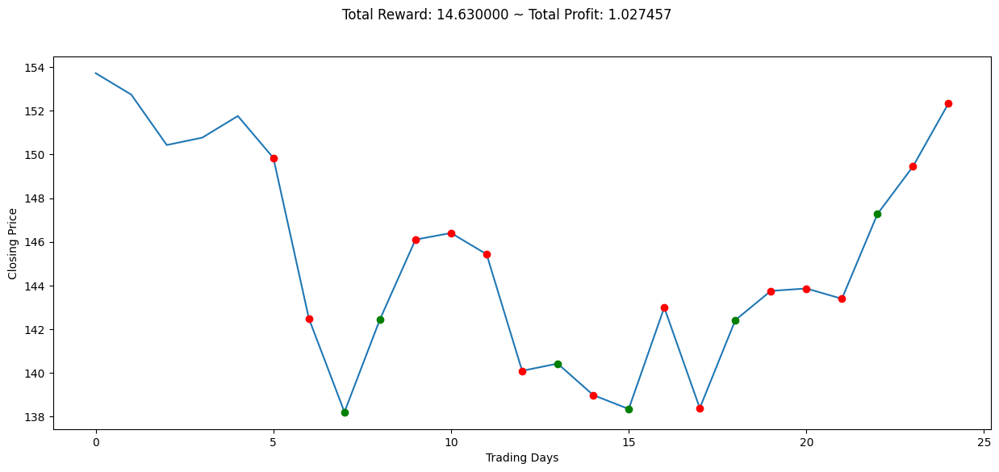

In [ ]:
# Evaluate the trained agent
eval_env = gym.make('stocks-v0', df=df, frame_bound=(90, 110), window_size=5)
obs = eval_env.reset()
while True:
    obs = obs[np.newaxis, ...]  # Reshape for non-vectorized environment
    action, _states = best_model_dqn.predict(obs)
    obs, rewards, done, info = eval_env.step(action)

    if done:
        print("info", info)

        # Render the environment
        plt.figure(figsize=(15, 6))
        plt.cla()
        eval_env.render_all()

        plt.xlabel('Trading Days')
        plt.ylabel('Closing Price')

        plt.show()
        break

### Custom DQN

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import gym_anytrading
import gym
import numpy as np

# Define the RNN-based Q-Network for Deep Q-Learning
class RNNQNetwork(nn.Module):
    def __init__(self, input_dim, output_dim, hidden_dim, n_layers):
        super(RNNQNetwork, self).__init__()
        self.hidden_dim = hidden_dim
        self.n_layers = n_layers

        # Define a GRU based recurrent layer
        self.rnn = nn.GRU(input_dim, hidden_dim, n_layers, batch_first=True)
        # Define a fully connected layer for Q-value prediction
        self.fc = nn.Linear(hidden_dim, output_dim)

    # Define forward propagation
    def forward(self, x, h):
        out, h = self.rnn(x, h)
        out = self.fc(out[:, -1, :])  # Use the last timestep to predict Q-values
        return out, h

    # Helper function to initialize hidden states
    def init_hidden(self, batch_size):
        weight = next(self.parameters()).data
        hidden = weight.new(self.n_layers, batch_size, self.hidden_dim).zero_()
        return hidden

# Deep Q-Learning Agent definition
class DeepQLearning:
    def __init__(self, input_dim, output_dim, hidden_dim, n_layers, lr, epsilon_decay):
        # Initialize Q-Network
        self.q_network = RNNQNetwork(input_dim, output_dim, hidden_dim, n_layers)
        self.optimizer = optim.Adam(self.q_network.parameters(), lr=lr)
        self.criterion = nn.MSELoss()
        # Parameters for epsilon-greedy action selection
        self.epsilon = 1.0
        self.epsilon_decay = epsilon_decay
        self.epsilon_min = 0.01

    # Get action using epsilon-greedy policy
    def get_action(self, state):
        if np.random.rand() < self.epsilon:  # Explore: take a random action
            return np.random.choice([0, 1])
        state = torch.FloatTensor(state).unsqueeze(0)
        hidden = self.q_network.init_hidden(1)
        # Exploit: take the action with the highest Q-value
        q_values, _ = self.q_network(state, hidden)
        action = torch.argmax(q_values).item()
        return action

    # Train the Q-Network using Bellman equation
    def update(self, state, action, reward, next_state, done):
        # Convert all to tensors
        state = torch.FloatTensor(state).unsqueeze(0)
        next_state = torch.FloatTensor(next_state).unsqueeze(0)
        action = torch.LongTensor([action])
        reward = torch.FloatTensor([reward])
        done = torch.FloatTensor([done])

        # Compute current Q-value
        current_q, _ = self.q_network(state, self.q_network.init_hidden(1))
        current_q = current_q[0][action]

        # Compute next Q-value
        next_q, _ = self.q_network(next_state, self.q_network.init_hidden(1))
        max_next_q = torch.max(next_q)

        # Calculate target Q-value
        expected_q = reward + (1 - done) * 0.99 * max_next_q

        # Compute and backpropagate the loss
        loss = self.criterion(current_q, expected_q.detach())
        self.optimizer.zero_grad()
        loss.backward()
        self.optimizer.step()

        return loss.item()

# Initialize environment
env = gym.make('stocks-v0', df=df, frame_bound=(5, 100), window_size=5)
agent = DeepQLearning(2, 2, 128, 2, 0.001, 0.995)

# Training loop
for episode in range(10):
    print('Episode:', episode)
    state = env.reset()
    done = False
    total_loss = 0
    step_count = 0

    while not done:
        action = agent.get_action(state)
        next_state, reward, done, info = env.step(action)
        loss = agent.update(state, action, reward, next_state, done)

        print()
        print(info)
        print(f'Episode: {episode}, Step: {step_count}, Loss: {loss}')
        print()

        state = next_state
        total_loss += loss
        step_count += 1

    avg_loss = total_loss / step_count
    print(f'Episode: {episode}, Average Loss: {avg_loss}')
    print()

    # Decay epsilon for epsilon-greedy policy
    agent.epsilon = max(agent.epsilon_min, agent.epsilon * agent.epsilon_decay)


Episode: 0

{'total_reward': 0.0, 'total_profit': 1.0, 'position': 1}
Episode: 0, Step: 0, Loss: 6.805558427913638e-07


{'total_reward': -0.799999999999983, 'total_profit': 0.9797837610264637, 'position': 0}
Episode: 0, Step: 1, Loss: 0.05634402856230736


{'total_reward': -0.799999999999983, 'total_profit': 0.9797837610264637, 'position': 1}
Episode: 0, Step: 2, Loss: 2.6589974368107505e-05


{'total_reward': -0.799999999999983, 'total_profit': 0.9797837610264637, 'position': 1}
Episode: 0, Step: 3, Loss: 1.4395450307347346e-05


{'total_reward': -4.1299999999999955, 'total_profit': 0.943524112558105, 'position': 0}
Episode: 0, Step: 4, Loss: 4.059596061706543


{'total_reward': -4.1299999999999955, 'total_profit': 0.943524112558105, 'position': 0}
Episode: 0, Step: 5, Loss: 2.402287006378174


{'total_reward': -4.1299999999999955, 'total_profit': 0.943524112558105, 'position': 0}
Episode: 0, Step: 6, Loss: 2.4316985607147217


{'total_reward': -4.1299999999999955, 'total_profit': 0.

In [ ]:
def evaluate(agent, env):
    total_reward = 0
    obs = env.reset()
    done = False
    while not done:
        action = agent.get_action(obs, epsilon=0)
        obs, reward, done, info = env.step(action)
        total_reward += reward
        print(info)

    return info

# Assuming the agent has been trained
eval_env = gym.make('stocks-v0', df=df, frame_bound=(90, 110), window_size=5)
info = evaluate(agent, eval_env)

print()
print(f"Total Reward: {info['total_reward']}")
print(f"Total Profit: {info['total_profit']}")


{'total_reward': 0.0, 'total_profit': 1.0, 'position': 0}
{'total_reward': 0.0, 'total_profit': 1.0, 'position': 0}
{'total_reward': 0.0, 'total_profit': 1.0, 'position': 0}
{'total_reward': 0.0, 'total_profit': 1.0, 'position': 1}
{'total_reward': 0.0, 'total_profit': 1.0, 'position': 1}
{'total_reward': -0.6699999999999875, 'total_profit': 0.980532659137577, 'position': 0}
{'total_reward': -0.6699999999999875, 'total_profit': 0.980532659137577, 'position': 0}
{'total_reward': -0.6699999999999875, 'total_profit': 0.980532659137577, 'position': 0}
{'total_reward': -0.6699999999999875, 'total_profit': 0.980532659137577, 'position': 0}
{'total_reward': -0.6699999999999875, 'total_profit': 0.980532659137577, 'position': 0}
{'total_reward': -0.6699999999999875, 'total_profit': 0.980532659137577, 'position': 0}
{'total_reward': -0.6699999999999875, 'total_profit': 0.980532659137577, 'position': 1}
{'total_reward': 3.3600000000000136, 'total_profit': 0.9940025511689912, 'position': 0}
{'tota

## Actor-Critic with RNN architecture for PPO and A2C

In [ ]:
import torch as th
from torch import nn
from typing import Callable, Dict, List, Optional, Tuple, Type, Union
from gym import spaces
from stable_baselines3.common.policies import ActorCriticPolicy
from stable_baselines3.common.callbacks import BaseCallback, EvalCallback, StopTrainingOnNoModelImprovement
from stable_baselines3.common.evaluation import evaluate_policy
from torch.nn import Conv1d, LSTM

class CustomNetwork(nn.Module):
    def __init__(
        self,
        feature_dim: int,
        last_layer_dim_pi: int = 8,
        last_layer_dim_vf: int = 8,
        conv_filters: int = 32,
        lstm_hidden_size: int = 64,
        lstm_num_layers: int = 1
    ):
        super().__init__()
        self.latent_dim_pi = last_layer_dim_pi
        self.latent_dim_vf = last_layer_dim_vf

        # Convolutional1D Layer for policy_net
        self.policy_conv = nn.Conv1d(in_channels=1, out_channels=conv_filters, kernel_size=3)

        # LSTM Layer for policy_net
        self.policy_lstm = nn.LSTM(
            input_size=conv_filters,
            hidden_size=lstm_hidden_size,
            num_layers=lstm_num_layers,
            batch_first=True
        )

        # Linear Layer for policy_net after LSTM
        self.policy_linear = nn.Linear(lstm_hidden_size, last_layer_dim_pi)

        # Convolutional1D Layer for value_net
        self.value_conv = nn.Conv1d(in_channels=1, out_channels=conv_filters, kernel_size=3)

        # LSTM Layer for value_net
        self.value_lstm = nn.LSTM(
            input_size=conv_filters,
            hidden_size=lstm_hidden_size,
            num_layers=lstm_num_layers,
            batch_first=True
        )

        # Linear Layer for value_net after LSTM
        self.value_linear = nn.Linear(lstm_hidden_size, last_layer_dim_vf)

    def forward(self, features: th.Tensor) -> Tuple[th.Tensor, th.Tensor]:
        return self.forward_actor(features), self.forward_critic(features)

    def forward_actor(self, features: th.Tensor) -> th.Tensor:
        x = features.unsqueeze(1)  # Add an extra dimension for Conv1D input
        x = self.policy_conv(x)
        x = x.squeeze(2)  # Remove the extra dimension added by Conv1D
        x = x.permute(0, 2, 1)  # Permute dimensions for LSTM input
        x, _ = self.policy_lstm(x)
        x = self.policy_linear(x[:, -1, :])  # Use only the last LSTM output

        return x

    def forward_critic(self, features: th.Tensor) -> th.Tensor:
        x = features.unsqueeze(1)  # Add an extra dimension for Conv1D input
        x = self.value_conv(x)
        x = x.squeeze(2)  # Remove the extra dimension added by Conv1D
        x = x.permute(0, 2, 1)  # Permute dimensions for LSTM input
        x, _ = self.value_lstm(x)
        x = self.value_linear(x[:, -1, :])  # Use only the last LSTM output

        return x

class CustomActorCriticPolicy(ActorCriticPolicy):
    def __init__(
        self,
        observation_space: spaces.Space,
        action_space: spaces.Space,
        lr_schedule: Callable[[float], float],
        *args,
        **kwargs,
    ):
        super().__init__(
            observation_space,
            action_space,
            lr_schedule=lr_schedule,
            *args,
            **kwargs,
        )
        self.ortho_init = False

    def _build_mlp_extractor(self) -> None:
        self.mlp_extractor = CustomNetwork(self.features_dim)


In [ ]:
tb_log = "./rlcustom_ac/"
env = gym.make('stocks-v0', df=df, frame_bound=(5, 100), window_size=5)
env = DummyVecEnv([lambda: env])

stop_train_callback = StopTrainingOnNoModelImprovement(max_no_improvement_evals=10, min_evals=100, verbose=1)
eval_callback = EvalCallback(env, eval_freq=1000, callback_after_eval=stop_train_callback, verbose=1)

# Create a PPO agent with the custom policy
best_model_ppo = PPO(CustomActorCriticPolicy, env, verbose=1, tensorboard_log=tb_log)

# best_model_ppo = PPO(policy=CustomActorCriticPolicy, env=env, learning_rate=best_params_ppo['learning_rate'],
#                     n_steps=best_params_ppo['n_steps'], batch_size=best_params_ppo['batch_size'],
#                     gamma=best_params_ppo['gamma'], gae_lambda=best_params_ppo['gae_lambda'], verbose=1, tensorboard_log=tb_log)

best_model_ppo.learn(total_timesteps=int(1e6), callback=eval_callback)


Using cuda device
Logging to ./rlcustom_ac/PPO_1
Eval num_timesteps=1000, episode_reward=0.00 +/- 0.00
Episode length: 94.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 94       |
|    mean_reward     | 0        |
| time/              |          |
|    total_timesteps | 1000     |
---------------------------------
New best mean reward!
Eval num_timesteps=2000, episode_reward=0.00 +/- 0.00
Episode length: 94.00 +/- 0.00
---------------------------------
| eval/              |          |
|    mean_ep_length  | 94       |
|    mean_reward     | 0        |
| time/              |          |
|    total_timesteps | 2000     |
---------------------------------
-----------------------------
| time/              |      |
|    fps             | 404  |
|    iterations      | 1    |
|    time_elapsed    | 5    |
|    total_timesteps | 2048 |
-----------------------------
Eval num_timesteps=3000, episode_reward=0.00 +/- 0.00
Episode length: 94.

info {'total_reward': 0.3299999999999841, 'total_profit': 0.9873704118780783, 'position': 0}


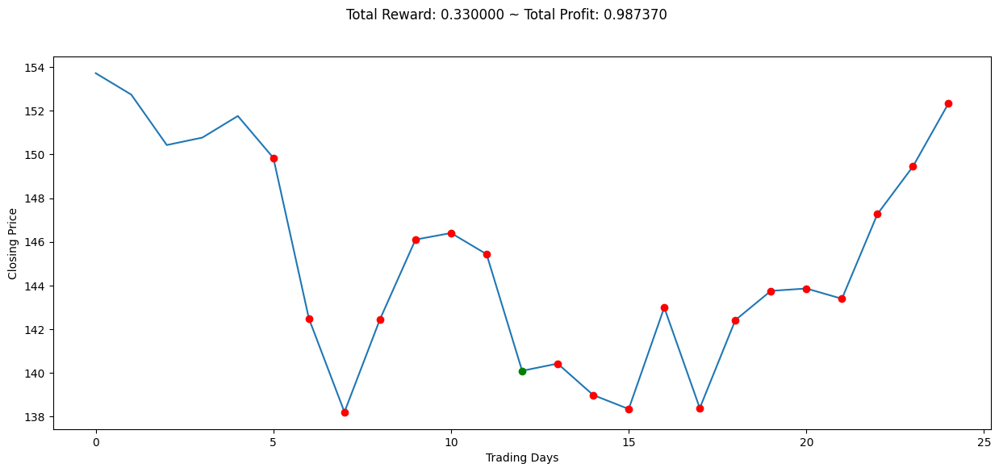

In [ ]:
# Evaluate the trained agent
eval_env = gym.make('stocks-v0', df=df, frame_bound=(90, 110), window_size=5)
obs = eval_env.reset()
while True:
    obs = obs[np.newaxis, ...]  # Reshape for non-vectorized environment
    action, _states = best_model_ppo.predict(obs)
    obs, rewards, done, info = eval_env.step(action)

    if done:
        print("info", info)

        # Render the environment
        plt.figure(figsize=(15, 6))
        plt.cla()
        eval_env.render_all()

        plt.xlabel('Trading Days')
        plt.ylabel('Closing Price')

        plt.show()
        break

In [ ]:
# Create a A2C agent with the custom policy
env = gym.make('stocks-v0', df=df, frame_bound=(5, 100), window_size=5)
env = DummyVecEnv([lambda: env])

stop_train_callback = StopTrainingOnNoModelImprovement(max_no_improvement_evals=10, min_evals=100, verbose=1)
eval_callback = EvalCallback(env, eval_freq=1000, callback_after_eval=stop_train_callback, verbose=1)

best_model_a2c = A2C(CustomActorCriticPolicy, env, verbose=1, tensorboard_log=tb_log)

# best_model_a2c = A2C(CustomActorCriticPolicy, env, learning_rate=best_params_a2c['learning_rate'],
#                     n_steps=best_params_a2c['n_steps'], gamma=best_params_a2c['gamma'], verbose=1, tensorboard_log=tb_log)
best_model_a2c.learn(total_timesteps=int(1e6), callback=eval_callback)


Using cuda device
Logging to ./rlcustom_ac/A2C_1
-------------------------------------
| time/                 |           |
|    fps                | 317       |
|    iterations         | 100       |
|    time_elapsed       | 1         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -0.693    |
|    explained_variance | -5.84e-06 |
|    learning_rate      | 0.0007    |
|    n_updates          | 99        |
|    policy_loss        | 2.72      |
|    value_loss         | 18.4      |
-------------------------------------
Eval num_timesteps=1000, episode_reward=0.00 +/- 0.00
Episode length: 94.00 +/- 0.00
-------------------------------------
| eval/                 |           |
|    mean_ep_length     | 94        |
|    mean_reward        | 0         |
| time/                 |           |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -0.693    |
|    explained_variance | -9.5

info {'total_reward': 6.349999999999994, 'total_profit': 0.9828521098070747, 'position': 0}


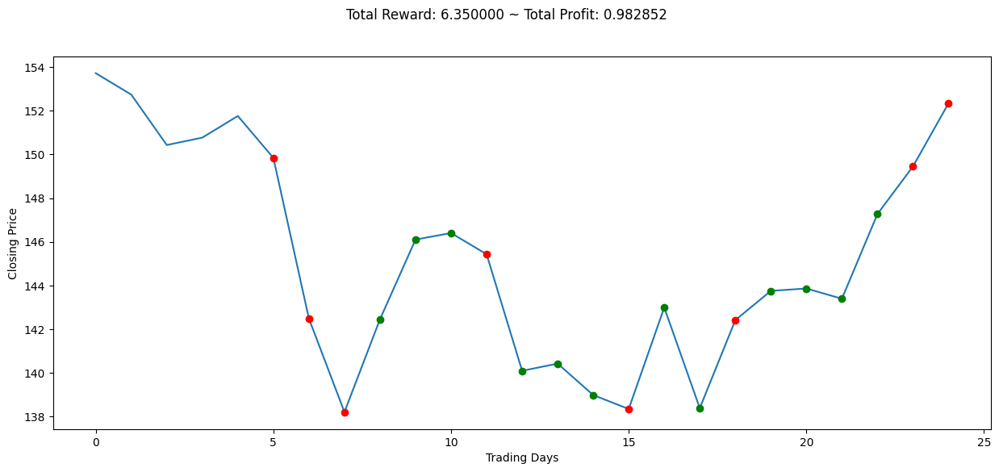

In [ ]:
eval_env = gym.make('stocks-v0', df=df, frame_bound=(90, 110), window_size=5)
obs = eval_env.reset()
while True:
    obs = obs[np.newaxis, ...]
    action, _states = best_model_a2c.predict(obs)
    obs, rewards, done, info = eval_env.step(action)

    if done:
        print("info", info)

        plt.figure(figsize=(15, 6))
        plt.cla()
        eval_env.render_all()

        plt.xlabel('Trading Days')
        plt.ylabel('Closing Price')

        plt.show()
        break


In [ ]:
# best_model_dqn.save('custom_dqn')
# best_model_ppo.save('custom_ppo')
# best_model_a2c.save('custom_a2c')

# custom_dqn = DQN.load("/content/drive/MyDrive/Advanced Computing/Individual Project/models/custom_dqn")
# custom_ppo = PPO.load("/content/drive/MyDrive/Advanced Computing/Individual Project/models/custom_ppo")
# custom_a2c = A2C.load("/content/drive/MyDrive/Advanced Computing/Individual Project/models/custom_a2c")

In [ ]:
from tensorboard import notebook

port_number = 6007
notebook.start(f"--logdir {tb_log} --port {port_number}")


<IPython.core.display.Javascript object>

### Custom A2C

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import gym_anytrading
import gym
import numpy as np

# RNN-based Actor-Critic Network definition
class RNNActorCriticNetwork(nn.Module):
    def __init__(self, input_dim, hidden_dim, n_layers, action_dim):
        super(RNNActorCriticNetwork, self).__init__()

        # GRU-based RNN layer
        self.rnn = nn.GRU(input_dim, hidden_dim, n_layers, batch_first=True)
        # Actor head: Decides the action to take
        self.actor = nn.Linear(hidden_dim, action_dim)
        # Critic head: Estimates the value of a state
        self.critic = nn.Linear(hidden_dim, 1)

    def forward(self, x, h):
        # Passing input through RNN
        x, h = self.rnn(x, h)
        # Using last timestep for action & value estimation
        x = x[:, -1, :]
        return self.actor(x), self.critic(x), h

# Define A2C Agent
class A2C:
    def __init__(self, input_dim, hidden_dim, n_layers, action_dim, lr, epsilon_decay):
        self.network = RNNActorCriticNetwork(input_dim, hidden_dim, n_layers, action_dim)
        self.optimizer = optim.Adam(self.network.parameters(), lr=lr)
        self.epsilon = 1.0
        self.epsilon_decay = epsilon_decay
        self.epsilon_min = 0.01

    def get_action(self, state):
        # Epsilon-greedy policy
        if np.random.rand() < self.epsilon:
            return np.random.choice([0, 1])

        state = torch.FloatTensor(state).unsqueeze(0)
        hidden = torch.zeros(self.network.rnn.num_layers, 1, self.network.rnn.hidden_size)

        # Getting action probabilities from the network
        probs, _, _ = self.network(state, hidden)
        action_probs = torch.distributions.Categorical(nn.functional.softmax(probs, dim=-1))

        return action_probs.sample().item()

    def update(self, state, action, reward, next_state, done):
        state = torch.FloatTensor(state).unsqueeze(0)
        next_state = torch.FloatTensor(next_state).unsqueeze(0)
        reward = torch.FloatTensor([reward])
        done = torch.FloatTensor([done])

        # Get current state value and next state value
        _, value, hidden = self.network(state, torch.zeros(self.network.rnn.num_layers, 1, self.network.rnn.hidden_size))
        _, next_value, _ = self.network(next_state, hidden)

        # Compute target and advantage
        td_target = reward + 0.99 * next_value * (1-done)
        delta = td_target - value

        # Compute actor and critic losses
        probs, _, _ = self.network(state, hidden)
        action_probs = torch.distributions.Categorical(nn.functional.softmax(probs, dim=-1))
        log_prob = action_probs.log_prob(torch.tensor([action]))
        actor_loss = -log_prob * delta.detach()
        critic_loss = delta.pow(2)

        # Combine losses and perform backprop
        loss = actor_loss + critic_loss
        self.optimizer.zero_grad()
        loss.backward()
        self.optimizer.step()

        return loss.item()

env = gym.make('stocks-v0', df=df, frame_bound=(5, 100), window_size=5)
agent = A2C(2, 128, 2, 2, 0.001, 0.995)

for episode in range(10):
    print('Episode:', episode)
    state = env.reset()
    done = False
    total_loss = 0
    step_count = 0

    while not done:
        action = agent.get_action(state)
        next_state, reward, done, info = env.step(action)
        loss = agent.update(state, action, reward, next_state, done)
        state = next_state
        total_loss += loss
        step_count += 1

        print()
        print(info)
        print(f'Episode: {episode}, Step: {step_count}, Loss: {loss}')
        print()

    avg_loss = total_loss/step_count
    print(f'Episode: {episode}, Average Loss: {avg_loss}')
    print()

    # Apply epsilon decay for epsilon-greedy policy
    agent.epsilon = max(agent.epsilon_min, agent.epsilon * agent.epsilon_decay)


Episode: 0

{'total_reward': 0.0, 'total_profit': 1.0, 'position': 1}
Episode: 0, Step: 1, Loss: -0.008026422001421452


{'total_reward': -0.799999999999983, 'total_profit': 0.9797837610264637, 'position': 0}
Episode: 0, Step: 2, Loss: 0.2150234878063202


{'total_reward': -0.799999999999983, 'total_profit': 0.9797837610264637, 'position': 1}
Episode: 0, Step: 3, Loss: 0.13071896135807037


{'total_reward': -0.799999999999983, 'total_profit': 0.9797837610264637, 'position': 1}
Episode: 0, Step: 4, Loss: 0.11811196804046631


{'total_reward': -4.1299999999999955, 'total_profit': 0.943524112558105, 'position': 0}
Episode: 0, Step: 5, Loss: 6.048964977264404


{'total_reward': -4.1299999999999955, 'total_profit': 0.943524112558105, 'position': 0}
Episode: 0, Step: 6, Loss: 0.34004634618759155


{'total_reward': -4.1299999999999955, 'total_profit': 0.943524112558105, 'position': 1}
Episode: 0, Step: 7, Loss: 0.0804002434015274


{'total_reward': -4.8799999999999955, 'total_profit': 0.92473

In [ ]:
def evaluate(agent, env):
    total_reward = 0
    obs = env.reset()
    done = False
    while not done:
        action = agent.get_action(obs)
        obs, reward, done, info = env.step(action)
        total_reward += reward
        print(info)

    return info

# Assuming the agent has been trained
eval_env = gym.make('stocks-v0', df=df, frame_bound=(90, 110), window_size=5)
info = evaluate(agent, eval_env)

print()
print(f"Total Reward: {info['total_reward']}")
print(f"Total Profit: {info['total_profit']}")


{'total_reward': 0.0, 'total_profit': 1.0, 'position': 0}
{'total_reward': 0.0, 'total_profit': 1.0, 'position': 0}
{'total_reward': 0.0, 'total_profit': 1.0, 'position': 0}
{'total_reward': 0.0, 'total_profit': 1.0, 'position': 0}
{'total_reward': 0.0, 'total_profit': 1.0, 'position': 0}
{'total_reward': 0.0, 'total_profit': 1.0, 'position': 0}
{'total_reward': 0.0, 'total_profit': 1.0, 'position': 0}
{'total_reward': 0.0, 'total_profit': 1.0, 'position': 0}
{'total_reward': 0.0, 'total_profit': 1.0, 'position': 0}
{'total_reward': 0.0, 'total_profit': 1.0, 'position': 0}
{'total_reward': 0.0, 'total_profit': 1.0, 'position': 0}
{'total_reward': 0.0, 'total_profit': 1.0, 'position': 0}
{'total_reward': 0.0, 'total_profit': 1.0, 'position': 0}
{'total_reward': 0.0, 'total_profit': 1.0, 'position': 1}
{'total_reward': 0.11000000000001364, 'total_profit': 0.9858037773913043, 'position': 0}
{'total_reward': 0.11000000000001364, 'total_profit': 0.9858037773913043, 'position': 1}
{'total_re

# **Custom Environment**

In [7]:
from finta import TA

df_appl = pd.read_csv('/content/drive/MyDrive/Advanced Computing/Individual Project/data/STOCK_US_XNAS_AAPL.csv')
df_amzn = pd.read_csv('/content/drive/MyDrive/Advanced Computing/Individual Project/data/STOCK_US_XNAS_AMZN.csv')
df_msft = pd.read_csv('/content/drive/MyDrive/Advanced Computing/Individual Project/data/STOCK_US_XNAS_MSFT.csv')

# Preprocess datasets of each stock
dfs = [df_appl, df_amzn, df_msft]
for df in dfs:
    df['Date'] = pd.to_datetime(df['Date'])
    df.sort_values('Date', inplace=True)
    df['Volume'] = df['Volume'].str.replace(',', '').astype(float)

    # Technical Indicators
    df['SMA'] = TA.SMA(df, 12)
    df['RSI'] = TA.RSI(df)
    df['OBV'] = TA.OBV(df)

# Add stock name as prefix for their respecting columns before concatenating into a single dataset.
df_appl.columns = ['AAPL_' + col for col in df_appl.columns]
df_amzn.columns = ['AMZN_' + col for col in df_amzn.columns]
df_msft.columns = ['MSFT_' + col for col in df_msft.columns]

df = pd.concat([df_appl, df_amzn, df_msft], axis=1)
df.dropna(inplace=True)
df


,AAPL_Date,AAPL_Open,AAPL_High,AAPL_Low,AAPL_Close,AAPL_Volume,AAPL_SMA,AAPL_RSI,AAPL_OBV,AMZN_Date,...,AMZN_OBV,MSFT_Date,MSFT_Open,MSFT_High,MSFT_Low,MSFT_Close,MSFT_Volume,MSFT_SMA,MSFT_RSI,MSFT_OBV
238,2022-01-26,163.50,164.39,157.82,159.69,108275297.0,167.675000,15.252611,-6.401550e+08,2022-01-26,...,-3.804467e+08,2022-01-26,307.99,308.50,293.03,296.71,90428852.0,303.975000,35.944331,71989685.0
237,2022-01-27,162.45,163.84,158.28,159.22,121954602.0,166.594167,14.719642,-7.621096e+08,2022-01-27,...,-3.029309e+08,2022-01-27,302.66,307.30,297.93,299.84,53481320.0,302.772500,40.972300,125471005.0
236,2022-01-28,165.71,170.35,162.80,170.33,179935703.0,166.198333,54.866828,-5.821739e+08,2022-01-28,...,-2.285389e+08,2022-01-28,300.23,308.48,294.45,308.26,49743699.0,302.212500,51.908283,175214704.0
235,2022-01-31,170.16,175.00,169.51,174.78,115541602.0,166.135833,62.484868,-4.666323e+08,2022-01-31,...,-1.502315e+08,2022-01-31,308.95,312.38,306.37,310.98,46444539.0,301.605000,54.820255,221659243.0
234,2022-02-01,174.01,174.84,172.31,174.61,86213914.0,166.337500,62.053954,-5.528462e+08,2022-02-01,...,-9.101166e+07,2022-02-01,310.41,310.63,305.13,308.76,40950398.0,301.935000,52.050080,180708845.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4,2022-12-30,128.41,129.95,127.43,129.93,77034211.0,132.836667,37.457906,-1.375950e+09,2022-12-30,...,-1.147716e+09,2022-12-30,238.21,239.96,236.66,239.82,21938471.0,242.236667,46.676617,-507536974.0
3,2023-01-03,130.28,130.90,124.17,125.07,112117508.0,131.325000,32.329421,-1.488068e+09,2023-01-03,...,-1.071009e+09,2023-01-03,243.08,245.75,237.40,239.58,25740039.0,240.766667,46.433012,-533277013.0
2,2023-01-04,126.89,128.66,125.08,126.36,89113633.0,130.480000,34.878075,-1.398954e+09,2023-01-04,...,-1.139895e+09,2023-01-04,232.28,232.87,225.96,229.10,50623391.0,239.107500,37.282829,-583900404.0
1,2023-01-05,127.13,127.77,124.76,125.02,80962711.0,129.689167,33.468005,-1.479917e+09,2023-01-05,...,-1.207825e+09,2023-01-05,227.20,227.55,221.76,222.31,39585621.0,237.242500,32.776174,-623486025.0


In [8]:
class MultiStockTradingEnv(gym.Env):
    def __init__(self, df, stocks):
        super(MultiStockTradingEnv, self).__init__()

        self.df = df
        self.stocks = stocks
        self.num_stocks = len(stocks)

        # Define a continuous action space range between -1 and 1 for each stock
        self.action_space = spaces.Box(low=-1, high=1, shape=(self.num_stocks,))

        # Observations are the close, low, volume, SMA, RSI, OBV, and our current holdings for each stock
        self.observation_space = spaces.Box(low=0, high=np.inf, shape=(7 * self.num_stocks,))

        # Initialize state
        self.reset()

    def step(self, actions):
        self.current_step += 1
        rewards = []
        for i, action in enumerate(actions):
            stock = self.stocks[i]
            action = np.clip(action, -1, 1)  # Normalize the action to the range of [0, 2], then shift it to [-1, 1] so that it can represent selling, holding, and buying
            previous_portfolio_value = self.balance[i] + self.holdings[i] * self.df[f'{stock}_Close'].iloc[self.current_step-1]
            self.holdings[i] += action * self.balance[i] / self.df[f'{stock}_Close'].iloc[self.current_step]
            self.balance[i] -= action * self.balance[i]
            portfolio_value = self.balance[i] + self.holdings[i] * self.df[f'{stock}_Close'].iloc[self.current_step]
            reward = portfolio_value - previous_portfolio_value
            rewards.append(reward)

            # Calculate profit for each stock
            profit = portfolio_value - self.initial_balances[i]
            self.profits[i].append(profit)

        done = self.current_step >= len(self.df.index) - 1
        obs = self._get_obs()

        return obs, np.mean(rewards), done, {}

    def reset(self):
        self.current_step = 0
        self.balance = [10000 for _ in range(self.num_stocks)]  # Initial balance for each stock
        self.initial_balances = self.balance.copy()  # Store the initial balance for profit calculation
        self.holdings = [0 for _ in range(self.num_stocks)]  # Initial holdings for each stock
        self.profits = [[] for _ in range(self.num_stocks)]  # Initialize profits for each stock as empty lists

        return self._get_obs()

    def render(self, mode='human'):
        for i, stock in enumerate(self.stocks):
            print(f'Stock: {stock}, Step: {self.current_step}, Balance: {self.balance[i]}, Holdings: {self.holdings[i]}')

    def _get_obs(self):
        obs = []
        for i, stock in enumerate(self.stocks):
            obs.extend([
                self.df[f'{stock}_Close'].iloc[self.current_step],
                self.df[f'{stock}_Low'].iloc[self.current_step],
                self.df[f'{stock}_Volume'].iloc[self.current_step],
                self.df[f'{stock}_SMA'].iloc[self.current_step],
                self.df[f'{stock}_RSI'].iloc[self.current_step],
                self.df[f'{stock}_OBV'].iloc[self.current_step],
                self.holdings[i]
            ])

        return np.array(obs, dtype=np.float32)


In [10]:
class EnsembleAgent:
    def __init__(self, a2c_model, ppo_model):
        self.a2c_model = a2c_model
        self.ppo_model = ppo_model

    def predict(self, obs):
        a2c_action, _ = self.a2c_model.predict(obs)
        ppo_action, _ = self.ppo_model.predict(obs)

        # Averaging the actions for each stock
        ensemble_action = (a2c_action + ppo_action) / 2.0

        return ensemble_action

# Define the stocks
stocks = ['AAPL', 'AMZN', 'MSFT']

# Split the data
train_size = int(len(df) * 0.8)  # 80% for training
train_df = df.iloc[:train_size]
test_df = df.iloc[train_size:]

# Initialize the environments
train_env = MultiStockTradingEnv(train_df, stocks)
test_env = MultiStockTradingEnv(test_df, stocks)

# Define the models
models = [A2C, PPO]
model_names = ['A2C', 'PPO']

agents = {}  # Store the trained agents
results = {}

# Train the models and evaluate them
for model, model_name in zip(models, model_names):
    print(f'Training {model_name}...')
    agent = model('MlpPolicy', train_env, verbose=1)
    agent.learn(total_timesteps=int(1e5))
    agents[model_name] = agent  # Store the agent

    # Evaluate the model and store the results
    print(f'Evaluating {model_name}...')
    obs = test_env.reset()
    balances, profits, actions = [], [], []
    done = False
    while not done:
        action, _ = agent.predict(obs)
        obs, reward, done, info = test_env.step(action)
        balances.append(test_env.balance.copy())
        profits.append([profit[-1] for profit in test_env.profits])  # Store the most recent profit for each stock
        actions.append(action.copy())

        print(f'Observation: {obs}, Action: {action}, Reward: {reward}, Done: {done}, Info: {info}')

    # Store the results
    results[model_name] = {
        'balances': balances,
        'profits': profits,
        'actions': actions
    }

# Evaluate the Ensemble Agent
ensemble_agent = EnsembleAgent(agents['A2C'], agents['PPO'])
print("Evaluating Ensemble Agent...")
obs = test_env.reset()
balances, profits, actions = [], [], []
done = False
while not done:
    action = ensemble_agent.predict(obs)
    print('ensemble: ', action)
    obs, reward, done, info = test_env.step(action)
    balances.append(test_env.balance.copy())
    profits.append([profit[-1] for profit in test_env.profits])
    actions.append(action.copy())

    print(f'Observation: {obs}, Action: {action}, Reward: {reward}, Done: {done}, Info: {info}')

results['Ensemble'] = {
    'balances': balances,
    'profits': profits,
    'actions': actions
}


Training A2C...
Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 189       |
|    ep_rew_mean        | -3.84e+03 |
| time/                 |           |
|    fps                | 409       |
|    iterations         | 100       |
|    time_elapsed       | 1         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -4.28     |
|    explained_variance | -0.00194  |
|    learning_rate      | 0.0007    |
|    n_updates          | 99        |
|    policy_loss        | 128       |
|    std                | 1.01      |
|    value_loss         | 8.77e+03  |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 189       |
|    ep_rew_mean        | -2.83e+03 |
| time/                 |           |
|    fps       

{'A2C': {'balances': [[0.0, 0.0, 6516.809463500977], [0.0, 0.0, 10954.699182902914], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0]], 'profits': [[0.0, 0.0, 0.0], [-175.42715534107083, -551.5423662631783, -59.42116281625022], [-541.9329594365463, -1007.4189769621244, -23.55338357290

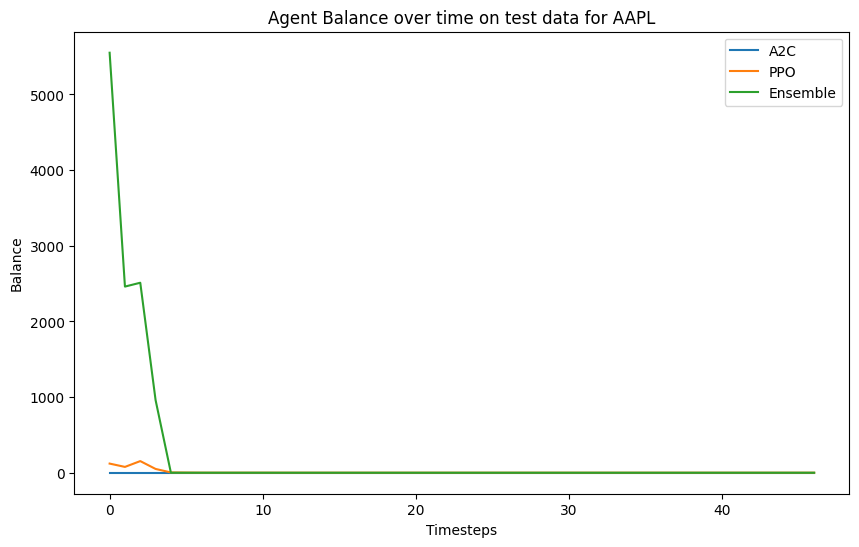

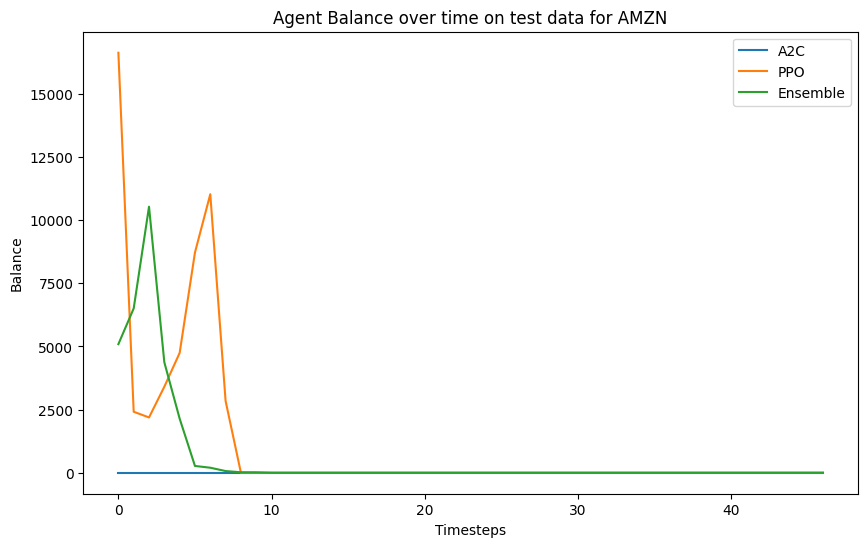

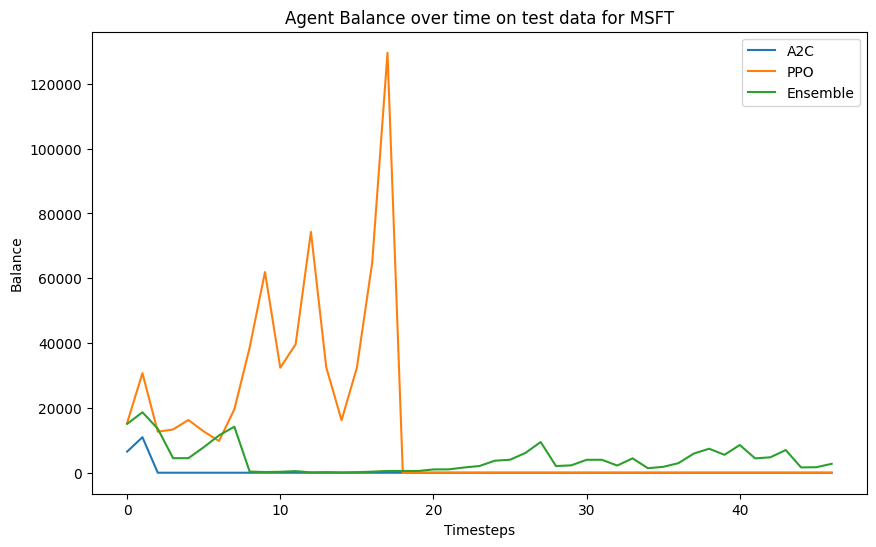

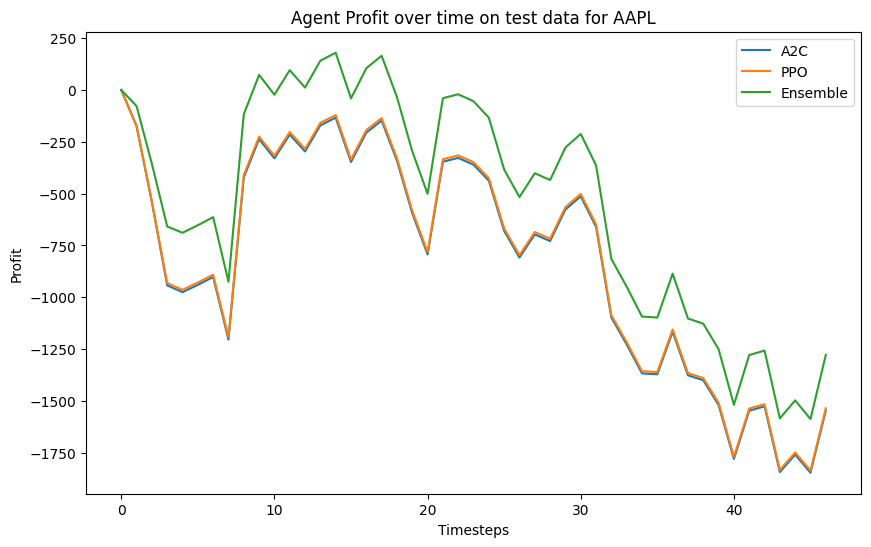

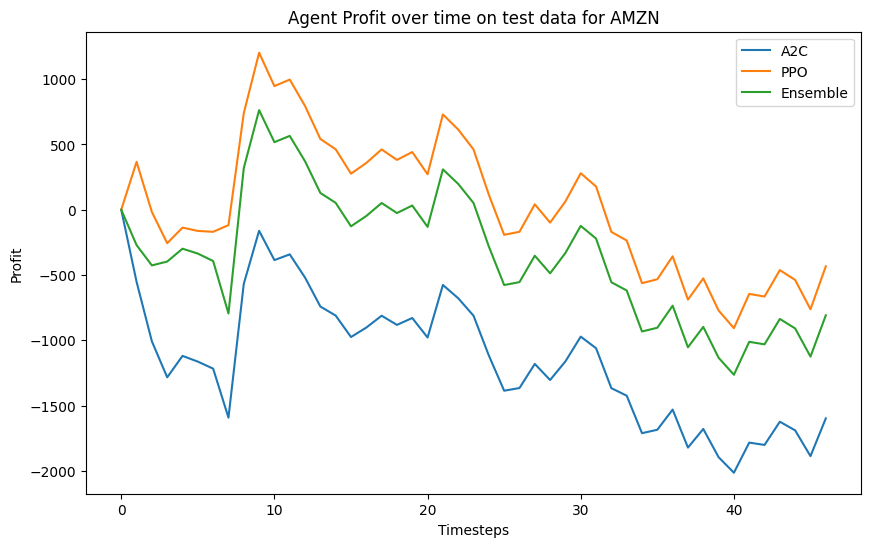

...

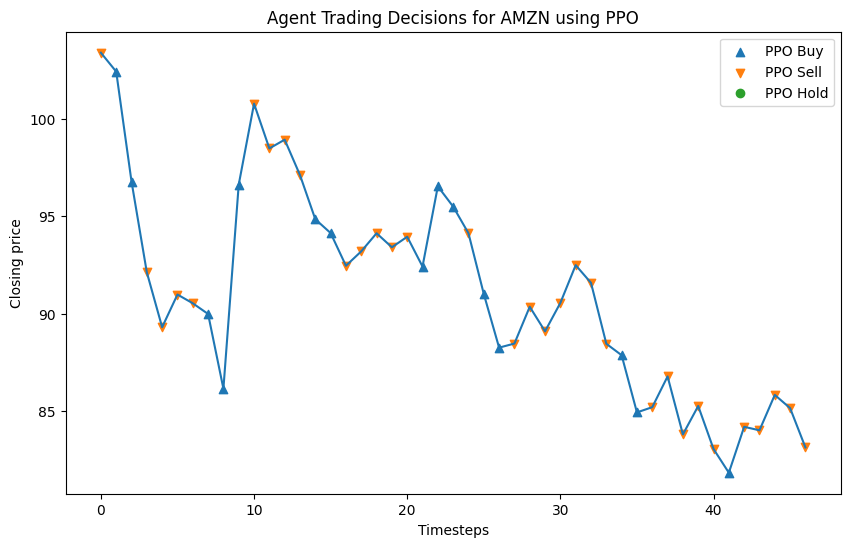

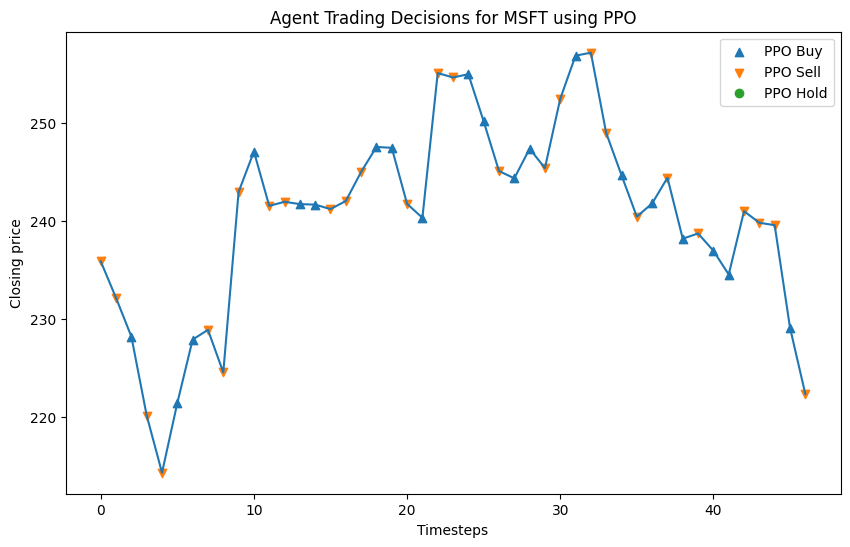

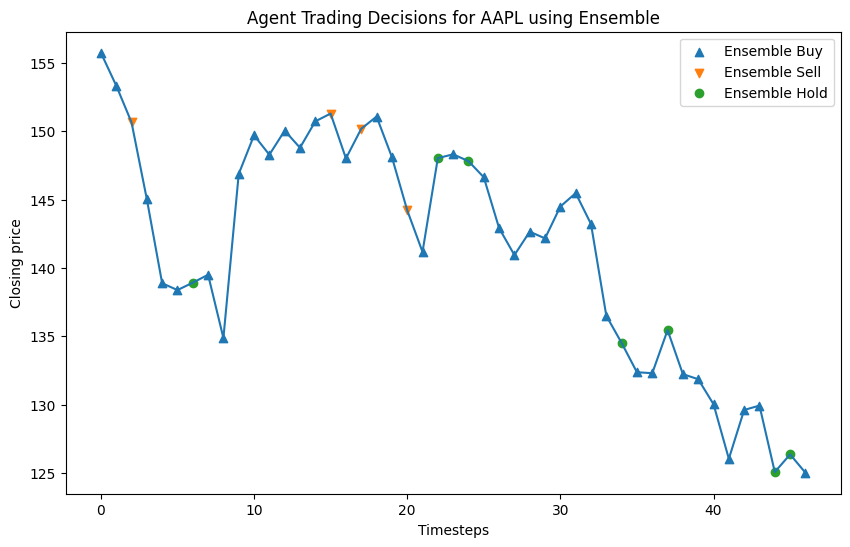

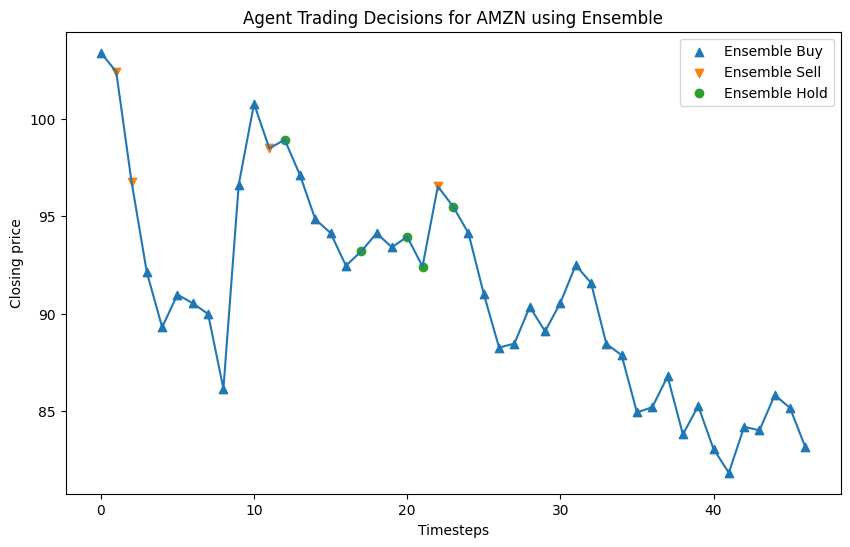

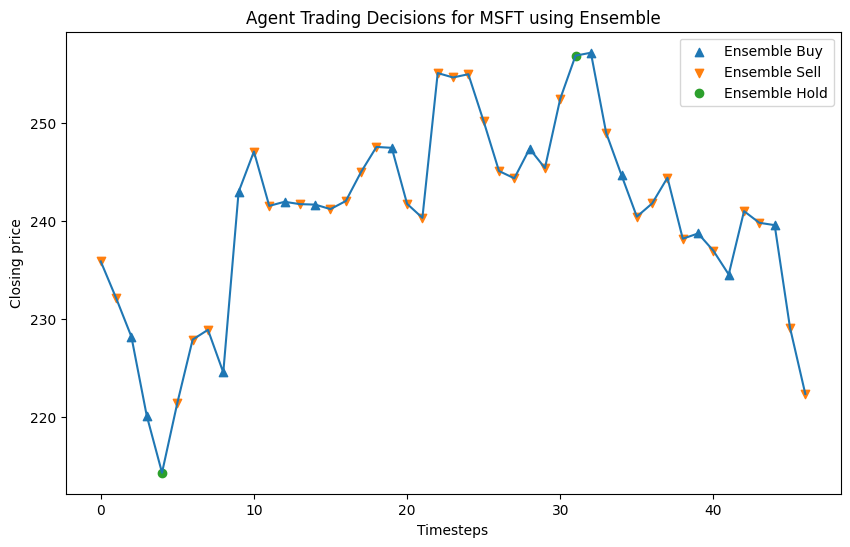

In [11]:
# Visualisations
print(results)

# Plot the balance on test data
for j, stock in enumerate(stocks):
    plt.figure(figsize=(10, 6))
    for model_name, data in results.items():
        plt.plot([balance[j] for balance in data['balances']], label=model_name)
    plt.title(f'Agent Balance over time on test data for {stock}')
    plt.xlabel('Timesteps')
    plt.ylabel('Balance')
    plt.legend()
    plt.show()

# Plot the profit on test data
for j, stock in enumerate(stocks):
    plt.figure(figsize=(10, 6))
    for model_name, data in results.items():
        plt.plot([profit[j] for profit in data['profits']], label=model_name)
    plt.title(f'Agent Profit over time on test data for {stock}')
    plt.xlabel('Timesteps')
    plt.ylabel('Profit')
    plt.legend()
    plt.show()

# Extract closing prices from the dataframe for visualization
for model_name, data in results.items():
    for j, stock in enumerate(stocks):
        closing_prices = test_df[f'{stock}_Close'].values[:len(data['actions'])]  # adjust to ensure length matches

        # Plot the closing prices on test data with markers for actions of the current model
        plt.figure(figsize=(10, 6))
        plt.plot(closing_prices)

        actions = data['actions']
        buy_points = [i for i, action in enumerate(actions) if action[j] > 0]
        sell_points = [i for i, action in enumerate(actions) if action[j] < 0]
        hold_points = [i for i, action in enumerate(actions) if action[j] == 0]

        plt.scatter(buy_points, [closing_prices[i] for i in buy_points], label=f'{model_name} Buy', marker='^')
        plt.scatter(sell_points, [closing_prices[i] for i in sell_points], label=f'{model_name} Sell', marker='v')
        plt.scatter(hold_points, [closing_prices[i] for i in hold_points], label=f'{model_name} Hold', marker='o')

        plt.title(f'Agent Trading Decisions for {stock} using {model_name}')
        plt.xlabel('Timesteps')
        plt.ylabel('Closing price')
        plt.legend()
        plt.show()

# **Evaluation**

In [ ]:
!pip install pyfolio

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 91.1/91.1 kB 5.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.8/52.8 kB 7.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 41.7 MB/s eta 0:00:00
  Created wheel for pyfolio: filename=pyfolio-0.9.2-py3-none-any.whl size=88663 sha256=59104b7fd63829f5fa10fe95061f7748b945711b606644e00848ef3b4308c9da
  Stored in directory: /root/.cache/pip/wheels/71/38/bc/e53700cfd8b0ad6b539d2fbaaf060ed8a299e7622a5b86ef42
  Created wheel for empyrical: filename=empyrical-0.5.5-py3-none-any.whl size=39762 sha256=bb4882f88c392c77f7ae377fe563e2dc7dac29ce1d1e98eacacf960b42dd1060
  Stored in directory: /root/.cache/pip/wheels/0e/2e/f2/d6d2d9a1eb8fbbd9949bb5d4c00f753e3b74e5bd7ed10b1d36
Successfully built pyfolio empyrical


In [ ]:
print("Actions")
print('PPO: ', actions_dict['PPO'])
print('A2C: ', actions_dict['A2C'])
print('DQN: ', actions_dict['DQN'])

print("\nPrices")
print('PPO: ', prices_dict['PPO'])
print('A2C: ', prices_dict['A2C'])
print('DQN: ', prices_dict['DQN'])

In [ ]:
ppo_actions = actions_dict['PPO']
ppo_actions = [int(action[0]) for action in ppo_actions]
ppo_prices = prices_dict['PPO']

a2c_actions = actions_dict['A2C']
a2c_actions = [int(action[0]) for action in a2c_actions]
a2c_prices = prices_dict['A2C']

dqn_actions = actions_dict['DQN']
dqn_actions = [int(action[0]) for action in dqn_actions]
dqn_prices = prices_dict['DQN']

In [ ]:
import pyfolio as pf

# Prepare the returns data for each model
ppo_returns = pd.Series(ppo_prices).pct_change().fillna(0)
a2c_returns = pd.Series(a2c_prices).pct_change().fillna(0)
dqn_returns = pd.Series(dqn_prices).pct_change().fillna(0)

# Create the returns DataFrame with a column for each model
returns_df = pd.DataFrame({
    'PPO': ppo_returns,
    'A2C': a2c_returns,
    'DQN': dqn_returns
})

print("Returns")
print(returns_df)
print()

# Generate pyfolio performance analysis for each model
for column in returns_df.columns:
    stats = pf.timeseries.perf_stats(returns_df[column])
    print(f"Performance statistics for {column}:")
    print(stats)
    print()


Returns
         PPO       A2C       DQN
0   0.000000  0.000000  0.000000
1  -0.030039 -0.030039 -0.030039
2   0.030753  0.030753  0.030753
3   0.025623  0.025623  0.025623
4   0.002053  0.002053  0.002053
5  -0.006626 -0.006626 -0.006626
6  -0.036719 -0.036719 -0.036719
7   0.002356  0.002356  0.002356
8  -0.010255 -0.010255 -0.010255
9  -0.004605 -0.004605 -0.004605
10  0.033613  0.033613  0.033613
11 -0.032240 -0.032240 -0.032240
12  0.029123  0.029123  0.029123
13  0.009409  0.009409  0.009409
14  0.000765  0.000765  0.000765
15 -0.003267 -0.003267 -0.003267
16  0.027059  0.027059  0.027059
17  0.014803  0.014803  0.014803
18  0.019338  0.019338  0.019338

Performance statistics for PPO:
Annual return           1.429003
Cumulative returns      0.069203
Annual volatility       0.339006
Sharpe ratio            2.783390
Calmar ratio           25.956075
Stability               0.214121
Max drawdown           -0.055055
Omega ratio             1.574894
Sortino ratio           4.397767
Sk

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/pyfolio/timeseries.py:724: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  stats = pd.Series()
/usr/local/lib/python3.10/dist-packages/pyfolio/timeseries.py:724: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  stats = pd.Series()
/usr/local/lib/python3.10/dist-packages/pyfolio/timeseries.py:724: FutureWarning: The default dtype for empty Series will be 'object' instead of 